# 1. Imports

In [501]:
# Standard Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import os
import joblib

# Data Profiling
from ydata_profiling import ProfileReport
import sweetviz as sv

# Statistical Analysis
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import RFE
from sklearn.decomposition import PCA

# Model Evaluation
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import cross_val_score

# Machine Learning Models
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.ensemble import (
    RandomForestRegressor,
    GradientBoostingRegressor,
    VotingRegressor,
    StackingRegressor,
)
import xgboost as xgb
import lightgbm as lgb
from lightgbm import early_stopping
from tensorflow.keras.callbacks import EarlyStopping

# Deep Learning
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Input
from tensorflow.keras.optimizers import Adam

# Optimization and Hyperparameter Tuning
import optuna
from optuna.integration import LightGBMPruningCallback

# Model Interpretability
import shap

# Experiment Tracking
import mlflow
import mlflow.sklearn

# 2. Data Loading and Initial Inspection

In [502]:
# Load the datasets
previous_lives_training = pd.read_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\raw\previous_lives_training_data.csv")
registration_data_training = pd.read_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\raw\registration_data_training.csv")
previous_lives_test = pd.read_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\raw\previous_lives_test_data.csv")
registration_data_test = pd.read_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\raw\registration_data_test.csv")

In [503]:
# Check basic information about each dataset
print("previous_lives_training")
print('='*30)
previous_lives_training_info = previous_lives_training.info()
print("\n")
print("registration_data_training")
print('='*30)
registration_data_training_info = registration_data_training.info()
print("\n")
print("previous_lives_test")
print('='*30)
previous_lives_test_info = previous_lives_test.info()
print("\n")
print("registration_data_test")
print('='*30)
registration_data_test_info = registration_data_test.info()

previous_lives_training
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 84941 entries, 0 to 84940
Data columns (total 11 columns):
 #   Column                              Non-Null Count  Dtype 
---  ------                              --------------  ----- 
 0   user_id                             84941 non-null  int64 
 1   registration_date                   84941 non-null  object
 2   registration_season_day             84941 non-null  int64 
 3   registration_country                84941 non-null  object
 4   registration_channel_detailed       84941 non-null  object
 5   registration_store                  84941 non-null  object
 6   registration_platform_specific      84941 non-null  object
 7   is_payer_lifetime                   84941 non-null  bool  
 8   days_active_lifetime                84941 non-null  int64 
 9   transaction_count_iap_lifetime      84941 non-null  int64 
 10  is_rewarded_video_watcher_lifetime  84941 non-null  bool  
dtypes: bool(2), int64(4), object(5

In [504]:
def missing_value_summary(data):
    # Calculate the number of missing values and their percentage
    missing_value = data.isnull().sum().reset_index()
    missing_value.columns = ['Variable', 'Number of Missing']
    missing_value['Percentage of Missing'] = (missing_value['Number of Missing'] / data.shape[0] * 100).round(2)

    # Sort the summary by the percentage of missing values in descending order
    missing_value = missing_value.sort_values(by='Percentage of Missing', ascending=False).reset_index(drop=True)

    return missing_value

In [505]:
# Display the missing value summary
missing_value_summary(previous_lives_training)

,Variable,Number of Missing,Percentage of Missing
0,user_id,0,0.0
1,registration_date,0,0.0
2,registration_season_day,0,0.0
3,registration_country,0,0.0
4,registration_channel_detailed,0,0.0
5,registration_store,0,0.0
6,registration_platform_specific,0,0.0
7,is_payer_lifetime,0,0.0
8,days_active_lifetime,0,0.0
9,transaction_count_iap_lifetime,0,0.0


In [506]:
# Check basic information about previous_lives_training dataset
print ("Rows     : " ,previous_lives_training.shape[0])
print ("Columns  : " ,previous_lives_training.shape[1])
print('='*30)
print ("Features : \n" ,previous_lives_training.columns.tolist())
print('='*30)
print ("Missing values :  ", previous_lives_training.isnull().sum().values.sum())
print('='*30)
print ("Unique values :  \n",previous_lives_training.nunique())

Rows     :  84941
Columns  :  11
Features : 
 ['user_id', 'registration_date', 'registration_season_day', 'registration_country', 'registration_channel_detailed', 'registration_store', 'registration_platform_specific', 'is_payer_lifetime', 'days_active_lifetime', 'transaction_count_iap_lifetime', 'is_rewarded_video_watcher_lifetime']
Missing values :   0
Unique values :  
 user_id                               50000
registration_date                       699
registration_season_day                  28
registration_country                    187
registration_channel_detailed             3
registration_store                        6
registration_platform_specific            7
is_payer_lifetime                         2
days_active_lifetime                    519
transaction_count_iap_lifetime          127
is_rewarded_video_watcher_lifetime        2
dtype: int64


- Columns and Data Types:

    - The dataset includes information on users' previous gameplay ("previous lives") before they re-registered.
    - user_id is an integer column used to uniquely identify users.
    - registration_date is stored as an object (string) and needs to be converted to datetime format for any time-based analysis.
    - Columns like is_payer_lifetime and is_rewarded_video_watcher_lifetime are boolean and indicate user behavior (e.g., whether they made in-app purchases or watched videos).
    - The rest are a mix of categorical (e.g., registration_country) and numerical features (e.g., days_active_lifetime).

- Missing Values: None.

- Key Observations:

    - All columns are non-null, indicating no missing data in this dataset.
    - Some columns are categorical (registration_country, registration_store), and their encoding will be necessary for model training.

In [507]:
# Display the missing value summary
missing_value_summary(registration_data_training)

,Variable,Number of Missing,Percentage of Missing
0,registration_device_manufacturer,1813,3.63
1,avg_age_top_11_players,3,0.01
2,user_id,0,0.00
3,transaction_count_rewarded_video,0,0.00
4,training_count,0,0.00
5,avg_stars_top_3_players,0,0.00
6,avg_stars_top_11_players,0,0.00
7,money_stash,0,0.00
8,morale_spent,0,0.00
9,treatments_spent,0,0.00


In [508]:
# Check basic information about registration_data_training dataset
print ("Rows     : " ,registration_data_training.shape[0])
print ("Columns  : " ,registration_data_training.shape[1])
print('='*30)
print ("Features : \n" ,registration_data_training.columns.tolist())
print('='*30)
print ("Missing values :  ", registration_data_training.isnull().sum().values.sum())
print('='*30)
print ("Unique values :  \n",registration_data_training.nunique())

Rows     :  50000
Columns  :  30
Features : 
 ['user_id', 'registration_time_utc', 'registration_platform_specific', 'registration_country', 'registration_store', 'registration_season_day', 'registration_channel_detailed', 'registration_device_type', 'registration_device_manufacturer', 'session_count', 'playtime', 'number_of_devices_used', 'total_match_played_count', 'total_match_won_count', 'total_match_watched_count', 'transaction_count_iap', 'transaction_count_rewarded_video', 'tokens_spent', 'tokens_stash', 'tokens_bought', 'rests_stash', 'rests_spent', 'treatments_spent', 'morale_spent', 'money_stash', 'avg_stars_top_11_players', 'avg_stars_top_3_players', 'avg_age_top_11_players', 'training_count', 'days_active_first_28_days_after_registration']
Missing values :   1816
Unique values :  
 user_id                                         50000
registration_time_utc                           49410
registration_platform_specific                      7
registration_country             

- Columns and Data Types:
    - This dataset captures user interactions on the day they re-registered.
    - registration_time_utc is an object and needs to be converted to datetime.
    - Columns like registration_platform_specific, registration_country, and registration_store are categorical and will require encoding.
    - avg_stars_top_11_players, avg_stars_top_3_players, and avg_age_top_11_players are float64, representing user statistics.
    - days_active_first_28_days_after_registration is the target variable (integer), ranging from 0 to 28.

- Missing Values:
    - registration_device_manufacturer has 1,813 missing values (about 3.6% of the dataset).
    - avg_age_top_11_players has 3 missing values, which is negligible.
- Key Observations:
    - The presence of missing values needs to be addressed (e.g., using imputation).
    - Categorical features need encoding, and datetime features need conversion.
    - The target variable (days_active_first_28_days_after_registration) is present, allowing us to proceed with model training.

In [509]:
# Display the missing value summary
missing_value_summary(previous_lives_test)

,Variable,Number of Missing,Percentage of Missing
0,user_id,0,0.0
1,registration_date,0,0.0
2,registration_season_day,0,0.0
3,registration_country,0,0.0
4,registration_channel_detailed,0,0.0
5,registration_store,0,0.0
6,registration_platform_specific,0,0.0
7,is_payer_lifetime,0,0.0
8,days_active_lifetime,0,0.0
9,transaction_count_iap_lifetime,0,0.0


In [510]:
# Check basic information about previous_lives_test dataset
print ("Rows     : " ,previous_lives_test.shape[0])
print ("Columns  : " ,previous_lives_test.shape[1])
print('='*30)
print ("Features : \n" ,previous_lives_test.columns.tolist())
print('='*30)
print ("Missing values :  ", previous_lives_test.isnull().sum().values.sum())
print('='*30)
print ("Unique values :  \n",previous_lives_test.nunique())

Rows     :  86113
Columns  :  11
Features : 
 ['user_id', 'registration_date', 'registration_season_day', 'registration_country', 'registration_channel_detailed', 'registration_store', 'registration_platform_specific', 'is_payer_lifetime', 'days_active_lifetime', 'transaction_count_iap_lifetime', 'is_rewarded_video_watcher_lifetime']
Missing values :   0
Unique values :  
 user_id                               50000
registration_date                       724
registration_season_day                  28
registration_country                    199
registration_channel_detailed             3
registration_store                        6
registration_platform_specific            7
is_payer_lifetime                         2
days_active_lifetime                    530
transaction_count_iap_lifetime          122
is_rewarded_video_watcher_lifetime        2
dtype: int64


- Columns and Data Types:
    - The structure and data types are identical to previous_lives_training.
    - This dataset contains information on users' previous gameplay before they re-registered (test set).
    - The boolean columns (is_payer_lifetime and is_rewarded_video_watcher_lifetime) need to be encoded.
- Missing Values: None.
- Key Observations:
    - Consistent structure with the training data.
    - No missing values, so preprocessing will focus on encoding and datetime conversion.

In [511]:
# Display the missing value summary
missing_value_summary(registration_data_test)

,Variable,Number of Missing,Percentage of Missing
0,registration_device_manufacturer,1659,3.32
1,user_id,0,0.00
2,transaction_count_iap,0,0.00
3,avg_age_top_11_players,1,0.00
4,avg_stars_top_3_players,0,0.00
5,avg_stars_top_11_players,0,0.00
6,money_stash,0,0.00
7,morale_spent,0,0.00
8,treatments_spent,0,0.00
9,rests_spent,0,0.00


In [512]:
# Check basic information about registration_data_test dataset
print ("Rows     : " ,registration_data_test.shape[0])
print ("Columns  : " ,registration_data_test.shape[1])
print('='*30)
print ("Features : \n" ,registration_data_test.columns.tolist())
print('='*30)
print ("Missing values :  ", registration_data_test.isnull().sum().values.sum())
print('='*30)
print ("Unique values :  \n",registration_data_test.nunique())

Rows     :  50000
Columns  :  29
Features : 
 ['user_id', 'registration_time_utc', 'registration_platform_specific', 'registration_country', 'registration_store', 'registration_season_day', 'registration_channel_detailed', 'registration_device_type', 'registration_device_manufacturer', 'session_count', 'playtime', 'number_of_devices_used', 'total_match_played_count', 'total_match_won_count', 'total_match_watched_count', 'transaction_count_iap', 'transaction_count_rewarded_video', 'tokens_spent', 'tokens_stash', 'tokens_bought', 'rests_stash', 'rests_spent', 'treatments_spent', 'morale_spent', 'money_stash', 'avg_stars_top_11_players', 'avg_stars_top_3_players', 'avg_age_top_11_players', 'training_count']
Missing values :   1660
Unique values :  
 user_id                             50000
registration_time_utc               49439
registration_platform_specific          7
registration_country                  187
registration_store                      7
registration_season_day          

- Columns and Data Types:
    - The structure is almost identical to registration_data_training, except for the absence of the target variable.
    - The categorical columns (registration_platform_specific, registration_country, etc.) require encoding.
    - The datetime column (registration_time_utc) needs conversion.    
- Missing Values:
    - registration_device_manufacturer has 1,659 missing values (about 3.3% of the dataset).
    - avg_age_top_11_players has only 1 missing value, which is negligible.
- Key Observations:
    - Consistent structure with the training data.
    - Missing values need to be addressed in the same way as in the training set (e.g., filling with "Unknown" or the mean value).
    - The absence of the target variable is expected since this is the test dataset.

# 3. Data Cleaning

In [513]:
# For 'registration_device_manufacturer', fill missing values with 'Unknown' in both training and test datasets
registration_data_training = registration_data_training.assign(
    registration_device_manufacturer=registration_data_training['registration_device_manufacturer'].fillna('Unknown')
)

registration_data_test = registration_data_test.assign(
    registration_device_manufacturer=registration_data_test['registration_device_manufacturer'].fillna('Unknown')
)

In [514]:
# For 'avg_age_top_11_players', find the mean in both training and test datasets
mean_age_top_11_train = registration_data_training['avg_age_top_11_players'].mean()
mean_age_top_11_test = registration_data_test['avg_age_top_11_players'].mean()
print(mean_age_top_11_train)
print(mean_age_top_11_test)

22.771246274776487
22.789435788715775


In [515]:
# For 'avg_age_top_11_players', fill missing values with the mean in both training and test datasets
registration_data_training = registration_data_training.assign(
    avg_age_top_11_players=registration_data_training['avg_age_top_11_players'].fillna(mean_age_top_11_train)
)

registration_data_test = registration_data_test.assign(
    avg_age_top_11_players=registration_data_test['avg_age_top_11_players'].fillna(mean_age_top_11_test)
)

In [516]:
# Verify that there are no missing values
print(registration_data_training.isnull().sum().values.sum())
print(registration_data_test.isnull().sum().values.sum())

0
0


In [517]:
# Convert date columns to datetime format
registration_data_training['registration_time_utc'] = pd.to_datetime(registration_data_training['registration_time_utc'])
previous_lives_training['registration_date'] = pd.to_datetime(previous_lives_training['registration_date'])
registration_data_test['registration_time_utc'] = pd.to_datetime(registration_data_test['registration_time_utc'])
previous_lives_test['registration_date'] = pd.to_datetime(previous_lives_test['registration_date'])

In [518]:
# Encode boolean columns to 0 and 1
bool_columns = ['is_payer_lifetime', 'is_rewarded_video_watcher_lifetime']

# Apply encoding in both training and test datasets where applicable
for col in bool_columns:
    if col in previous_lives_training.columns:
        previous_lives_training[col] = previous_lives_training[col].astype(int)
    if col in previous_lives_test.columns:
        previous_lives_test[col] = previous_lives_test[col].astype(int)

In [519]:
# Describe the 'registration_data_training' dataset
registration_data_training.describe().T

,count,mean,std,min,25%,50%,75%,max
user_id,50000.0,1.098442e+05,6.321900e+04,5.0,5.507075e+04,1.095710e+05,1.650918e+05,2.189560e+05
registration_season_day,50000.0,1.361398e+01,8.048579e+00,1.0,7.000000e+00,1.300000e+01,2.100000e+01,2.800000e+01
session_count,50000.0,2.254440e+00,2.107337e+00,0.0,1.000000e+00,2.000000e+00,3.000000e+00,5.200000e+01
playtime,50000.0,1.938928e+06,2.452801e+06,0.0,3.527005e+05,1.151846e+06,2.609020e+06,5.817359e+07
number_of_devices_used,50000.0,1.003200e+00,1.160605e-01,0.0,1.000000e+00,1.000000e+00,1.000000e+00,4.000000e+00
total_match_played_count,50000.0,1.013760e+00,1.624298e+00,0.0,0.000000e+00,1.000000e+00,1.000000e+00,2.900000e+01
total_match_won_count,50000.0,7.098200e-01,1.223685e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,1.700000e+01
total_match_watched_count,50000.0,3.581400e-01,9.519527e-01,0.0,0.000000e+00,0.000000e+00,0.000000e+00,1.900000e+01
transaction_count_iap,50000.0,2.040000e-02,2.521609e-01,0.0,0.000000e+00,0.000000e+00,0.000000e+00,1.500000e+01
transaction_count_rewarded_video,50000.0,1.403980e+00,4.470676e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,5.800000e+01


We observe some negative values in token_stash and money stash. We will explore more on them.

In [520]:
# Calculate the count and percentage of negative values directly for both 'tokens_stash' and 'money_stash'
negative_tokens_count = (registration_data_training['tokens_stash'] < 0).sum()
negative_tokens_percentage = (negative_tokens_count / len(registration_data_training)) * 100

negative_money_count = (registration_data_training['money_stash'] < 0).sum()
negative_money_percentage = (negative_money_count / len(registration_data_training)) * 100

# Compile the results
negative_values_summary = {
    'Negative Tokens Count': negative_tokens_count,
    'Negative Tokens Percentage': negative_tokens_percentage,
    'Negative Money Count': negative_money_count,
    'Negative Money Percentage': negative_money_percentage
}

negative_values_summary

{'Negative Tokens Count': 14,
 'Negative Tokens Percentage': 0.027999999999999997,
 'Negative Money Count': 24,
 'Negative Money Percentage': 0.048}

- Negative values in tokens_stash and money_stash are unexpected because it represents the amount of tokens left in the user's stash at the end of the first day of registration. This suggests data errors or anomalies, as these amounts should logically be non-negative.
- Setting negative values to zero makes logical sense because these values should not fall below zero.
- The percentage of affected entries is minimal (less than 0.05%), so the imputation method with zero has a negligible impact on the dataset as a whole.
- We will perform the imputation in the test dataset as well, ensuring consistency in handling these anomalies.


In [521]:
# Replace negative values with zero in 'tokens_stash' and 'money_stash'
registration_data_training['tokens_stash'] = registration_data_training['tokens_stash'].apply(lambda x: max(x, 0))
registration_data_training['money_stash'] = registration_data_training['money_stash'].apply(lambda x: max(x, 0))

# Verify replacement by checking the minimum values of these columns
min_tokens_stash = registration_data_training['tokens_stash'].min()
min_money_stash = registration_data_training['money_stash'].min()

min_tokens_stash, min_money_stash

(0, 0)

In [522]:
# Describe the 'previous_lives_training' dataset
previous_lives_training.describe().T

,count,mean,std,min,25%,50%,75%,max
user_id,84941.0,105724.313312,63599.357303,5.0,51738.0,100428.0,161383.0,218956.0
registration_season_day,84941.0,14.245759,8.085758,1.0,7.0,14.0,21.0,28.0
is_payer_lifetime,84941.0,0.080738,0.272435,0.0,0.0,0.0,0.0,1.0
days_active_lifetime,84941.0,25.035801,50.654498,1.0,2.0,6.0,24.0,650.0
transaction_count_iap_lifetime,84941.0,0.624928,4.969772,0.0,0.0,0.0,0.0,313.0
is_rewarded_video_watcher_lifetime,84941.0,0.498664,0.500001,0.0,0.0,0.0,1.0,1.0


In [523]:
# Describe the 'registration_data_test' dataset
registration_data_test.describe().T

,count,mean,std,min,25%,50%,75%,max
user_id,50000.0,4.066165e+05,6.124873e+04,300004.0,3.534595e+05,4.068960e+05,4.597528e+05,5.127130e+05
registration_season_day,50000.0,1.375538e+01,8.142787e+00,1.0,7.000000e+00,1.400000e+01,2.100000e+01,2.800000e+01
session_count,50000.0,2.214980e+00,2.080291e+00,0.0,1.000000e+00,1.000000e+00,3.000000e+00,3.800000e+01
playtime,50000.0,1.996999e+06,2.626581e+06,0.0,3.158190e+05,1.115410e+06,2.691062e+06,5.679172e+07
number_of_devices_used,50000.0,1.001940e+00,1.192331e-01,0.0,1.000000e+00,1.000000e+00,1.000000e+00,4.000000e+00
total_match_played_count,50000.0,1.882080e+00,3.933518e+00,0.0,0.000000e+00,1.000000e+00,2.000000e+00,7.100000e+01
total_match_won_count,50000.0,1.189460e+00,2.649284e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,3.800000e+01
total_match_watched_count,50000.0,4.466800e-01,1.003104e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,2.000000e+01
transaction_count_iap,50000.0,2.242000e-02,2.538477e-01,0.0,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+01
transaction_count_rewarded_video,50000.0,1.262500e+00,4.216941e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,6.000000e+01


In [524]:
# Calculate the count and percentage of negative values for both 'tokens_stash', 'money_stash', and 'rests_stash' in the test dataset
negative_tokens_count_test = (registration_data_test['tokens_stash'] < 0).sum()
negative_tokens_percentage_test = (negative_tokens_count_test / len(registration_data_test)) * 100

negative_money_count_test = (registration_data_test['money_stash'] < 0).sum()
negative_money_percentage_test = (negative_money_count_test / len(registration_data_test)) * 100

negative_rests_count_test = (registration_data_test['rests_stash'] < 0).sum()
negative_rests_percentage_test = (negative_rests_count_test / len(registration_data_test)) * 100

# Compile the results
negative_values_summary_test = {
    'Negative Tokens Count': negative_tokens_count_test,
    'Negative Tokens Percentage': negative_tokens_percentage_test,
    'Negative Money Count': negative_money_count_test,
    'Negative Money Percentage': negative_money_percentage_test,
    'Negative Rests Count': negative_rests_count_test,
    'Negative Rests Percentage': negative_rests_percentage_test
}

negative_values_summary_test

{'Negative Tokens Count': 10,
 'Negative Tokens Percentage': 0.02,
 'Negative Money Count': 37,
 'Negative Money Percentage': 0.074,
 'Negative Rests Count': 1,
 'Negative Rests Percentage': 0.002}

In [525]:
# Replace negative values with zero in 'tokens_stash', 'money_stash', and 'rests_stash' in the test dataset
registration_data_test['tokens_stash'] = registration_data_test['tokens_stash'].apply(lambda x: max(x, 0))
registration_data_test['money_stash'] = registration_data_test['money_stash'].apply(lambda x: max(x, 0))
registration_data_test['rests_stash'] = registration_data_test['rests_stash'].apply(lambda x: max(x, 0))

# Verify replacement by checking the minimum values of these columns
min_tokens_stash_test = registration_data_test['tokens_stash'].min()
min_money_stash_test = registration_data_test['money_stash'].min()
min_rests_stash_test = registration_data_test['rests_stash'].min()

min_tokens_stash_test, min_money_stash_test, min_rests_stash_test

(0, 0, 0)

In [526]:
# Describe the 'previous_lives_test' dataset
previous_lives_test.describe().T

,count,mean,std,min,25%,50%,75%,max
user_id,86113.0,402773.135136,61894.428895,300004.0,349829.0,397061.0,456579.0,512713.0
registration_season_day,86113.0,14.264014,8.088610,1.0,7.0,14.0,21.0,28.0
is_payer_lifetime,86113.0,0.079605,0.270682,0.0,0.0,0.0,0.0,1.0
days_active_lifetime,86113.0,23.868011,50.284480,1.0,2.0,6.0,22.0,683.0
transaction_count_iap_lifetime,86113.0,0.603637,5.093712,0.0,0.0,0.0,0.0,376.0
is_rewarded_video_watcher_lifetime,86113.0,0.480369,0.499617,0.0,0.0,0.0,1.0,1.0


# 4. Feature Engineering

In [527]:
# Convert 'playtime' from milliseconds to minutes in both training and test datasets
registration_data_training['playtime'] = registration_data_training['playtime'] / 60000  # 1 minute = 60,000 milliseconds
registration_data_test['playtime'] = registration_data_test['playtime'] / 60000

# Verify the transformation by checking the statistics for 'playtime' in minutes
playtime_stats_training = registration_data_training['playtime'].describe()
playtime_stats_test = registration_data_test['playtime'].describe()

print(f"Playtime Training Statistics \n{playtime_stats_training}")
print(f"\nPlaytime Test Statistics \n{playtime_stats_test}")

Playtime Training Statistics 
count    50000.000000
mean        32.315468
std         40.880019
min          0.000000
25%          5.878342
50%         19.197433
75%         43.483663
max        969.559767
Name: playtime, dtype: float64

Playtime Test Statistics 
count    50000.000000
mean        33.283313
std         43.776353
min          0.000000
25%          5.263650
50%         18.590158
75%         44.851025
max        946.528600
Name: playtime, dtype: float64


- The mean playtime is slightly higher in the test dataset (33.28 minutes) compared to the training dataset (32.32 minutes).
- The standard deviation is also higher in the test dataset (43.78 minutes) than in the training dataset (40.88 minutes), indicating more variability in the test set.
- The minimum value for both datasets is 0, which likely indicates users who registered but did not play at all on the first day.
- The maximum playtime is very high in both datasets (around 946 to 970 minutes), suggesting that some users played for a significantly long time on the first day, which could be outliers or power users.

In [528]:
# Aggregate the `previous_lives_training` data by `user_id`
previous_lives_training_aggregated = previous_lives_training.groupby('user_id').agg({    
    'is_payer_lifetime': 'max',                           # Has the user ever made an in-app purchase
    'days_active_lifetime': 'sum',                        # Total days active across all lives
    'transaction_count_iap_lifetime': 'sum',              # Total transactions across lives
    'is_rewarded_video_watcher_lifetime': 'max'           # Has the user ever watched a rewarded video
}).reset_index()

In [529]:
# Aggregate the `previous_lives_test` data by `user_id` using the same logic
previous_lives_test_aggregated = previous_lives_test.groupby('user_id').agg({    
    'is_payer_lifetime': 'max',                           # Has the user ever made an in-app purchase
    'days_active_lifetime': 'sum',                        # Total days active across all lives
    'transaction_count_iap_lifetime': 'sum',              # Total transactions across lives
    'is_rewarded_video_watcher_lifetime': 'max'           # Has the user ever watched a rewarded video
}).reset_index()

In [530]:
# Verify the structure and summary of the aggregated training and test data
previous_lives_training_aggregated.describe().T

,count,mean,std,min,25%,50%,75%,max
user_id,50000.0,109844.23910,63219.003941,5.0,55070.75,109571.0,165091.75,218956.0
is_payer_lifetime,50000.0,0.12350,0.329014,0.0,0.00,0.0,0.00,1.0
days_active_lifetime,50000.0,42.53132,66.123853,1.0,4.00,17.0,51.00,650.0
transaction_count_iap_lifetime,50000.0,1.06164,6.763369,0.0,0.00,0.0,0.00,335.0
is_rewarded_video_watcher_lifetime,50000.0,0.63244,0.482146,0.0,0.00,1.0,1.00,1.0


In [531]:
# Verify the structure and summary of the aggregated training and test data
previous_lives_test_aggregated.describe().T

,count,mean,std,min,25%,50%,75%,max
user_id,50000.0,406616.48200,61248.729756,300004.0,353459.5,406896.0,459752.75,512713.0
is_payer_lifetime,50000.0,0.12230,0.327635,0.0,0.0,0.0,0.00,1.0
days_active_lifetime,50000.0,41.10692,66.363991,1.0,4.0,15.0,48.00,683.0
transaction_count_iap_lifetime,50000.0,1.03962,7.179864,0.0,0.0,0.0,0.00,700.0
is_rewarded_video_watcher_lifetime,50000.0,0.61140,0.487437,0.0,0.0,1.0,1.00,1.0


In [532]:
# Merge the aggregated previous lives data with registration data for both training and test sets

# Training merge
training_data = pd.merge(registration_data_training, previous_lives_training_aggregated, on='user_id', how='left')

# Test merge
test_data = pd.merge(registration_data_test, previous_lives_test_aggregated, on='user_id', how='left')

# Verify the structure and summary of the merged datasets
training_data_info = training_data.describe().T
test_data_info = test_data.describe().T

We will map countries to continents in order to reduce dimensionality in machine learning models. This will simplify the representation of geographical information, capture underlying patterns that contribute to the target variable and will also reduse noise.

In [533]:
training_data['registration_country'].unique()

array(['France', 'Turkey', 'Belarus', 'Indonesia', 'Egypt', 'Spain',
       'Brazil', 'Germany', 'Iraq', 'Malaysia', 'Poland', 'Romania',
       'Belgium', 'Israel', 'Croatia', 'Italy', 'United Arab Emirates',
       'Greece', 'Saudi Arabia', 'Slovakia', 'Azerbaijan', 'Japan',
       'Ukraine', 'Kosovo', 'India', 'Algeria', 'United States',
       'United Kingdom', 'Sweden', 'Netherlands', 'Equatorial Guinea',
       'Switzerland', 'Czech Republic', 'Austria', 'Argentina',
       'Bulgaria', 'Serbia', 'China', 'Cambodia', 'Portugal', 'Thailand',
       'Suriname', 'Paraguay', 'El Salvador',
       'Tanzania, United Republic of', 'Colombia', 'Nigeria', 'Vietnam',
       'Uzbekistan', 'Moldova, Republic of', 'Canada', 'Denmark',
       'Korea, Republic of', 'Kazakhstan', 'Morocco', 'Lebanon',
       'Venezuela', 'Cyprus', 'Oman', 'Georgia', 'Albania', 'Macedonia',
       'Singapore', 'Mexico', 'Trinidad and Tobago', 'Ecuador', 'Hungary',
       'Bolivia', 'Jamaica', "Lao People's Democra

In [534]:
# Mapping of countries to continents
country_to_continent = {
    'Portugal': 'Europe',
    'Turkey': 'Asia',
    'Belgium': 'Europe',
    'Malaysia': 'Asia',
    'Italy': 'Europe',
    'Cambodia': 'Asia',
    'Indonesia': 'Asia',
    'Algeria': 'Africa',
    'Spain': 'Europe',
    'Costa Rica': 'North America',
    'Argentina': 'South America',
    'Germany': 'Europe',
    'Saudi Arabia': 'Asia',
    'Thailand': 'Asia',
    'Austria': 'Europe',
    'Korea, Republic of': 'Asia',
    'South Africa': 'Africa',
    'Romania': 'Europe',
    'Greece': 'Europe',
    'Netherlands': 'Europe',
    'Bulgaria': 'Europe',
    'Czech Republic': 'Europe',
    'Nigeria': 'Africa',
    'France': 'Europe',
    'Somalia': 'Africa',
    'Brazil': 'South America',
    'United States': 'North America',
    'Chile': 'South America',
    'Poland': 'Europe',
    'United Kingdom': 'Europe',
    'Israel': 'Asia',
    'Jersey': 'Europe',
    'Bosnia and Herzegovina': 'Europe',
    'Norway': 'Europe',
    'Cyprus': 'Asia',
    'Slovakia': 'Europe',
    'Ireland': 'Europe',
    'Switzerland': 'Europe',
    'Mexico': 'North America',
    'Uruguay': 'South America',
    'Andorra': 'Europe',
    'Japan': 'Asia',
    'Serbia': 'Europe',
    'India': 'Asia',
    'Egypt': 'Africa',
    'Slovenia': 'Europe',
    'Albania': 'Europe',
    'Croatia': 'Europe',
    'Canada': 'North America',
    'China': 'Asia',
    'Botswana': 'Africa',
    'Colombia': 'South America',
    'Sweden': 'Europe',
    'Niger': 'Africa',
    'Azerbaijan': 'Asia',
    'Ukraine': 'Europe',
    'Ecuador': 'South America',
    'Russian Federation': 'Europe',
    'Senegal': 'Africa',
    'Luxembourg': 'Europe',
    'Myanmar': 'Asia',
    'Monaco': 'Europe',
    'Georgia': 'Asia',
    'Vietnam': 'Asia',
    'Tunisia': 'Africa',
    'Hong Kong': 'Asia',
    'Peru': 'South America',
    'Dominica': 'North America',
    'Bangladesh': 'Asia',
    'Lebanon': 'Asia',
    'Venezuela': 'South America',
    'Hungary': 'Europe',
    'Uzbekistan': 'Asia',
    'Congo, The Democratic Republic of the': 'Africa',
    'New Zealand': 'Oceania',
    'Afghanistan': 'Asia',
    'Nicaragua': 'North America',
    'Iraq': 'Asia',
    'Jordan': 'Asia',
    'Morocco': 'Africa',
    "Cote D'Ivoire": 'Africa',
    'Yemen': 'Asia',
    'Denmark': 'Europe',
    'Reunion': 'Africa',
    'Haiti': 'North America',
    'Macedonia': 'Europe',
    'United Arab Emirates': 'Asia',
    'Ghana': 'Africa',
    'Oman': 'Asia',
    'Malta': 'Europe',
    'Australia': 'Oceania',
    'Namibia': 'Africa',
    'Nepal': 'Asia',
    'Kazakhstan': 'Asia',
    'Philippines': 'Asia',
    'Taiwan': 'Asia',
    'Guatemala': 'North America',
    'Finland': 'Europe',
    'Kuwait': 'Asia',
    'Benin': 'Africa',
    'Singapore': 'Asia',
    'Europe': 'Europe',
    'Sudan': 'Africa',
    'Armenia': 'Asia',
    'Macau': 'Asia',
    'Kenya': 'Africa',
    'Barbados': 'North America',
    'Iran, Islamic Republic of': 'Asia',
    'Trinidad and Tobago': 'North America',
    'Lithuania': 'Europe',
    'Paraguay': 'South America',
    'Gabon': 'Africa',
    'Moldova, Republic of': 'Europe',
    'Libya': 'Africa',
    'Rwanda': 'Africa',
    'Kosovo': 'Europe',
    'Cameroon': 'Africa',
    'Honduras': 'North America',
    'Zimbabwe': 'Africa',
    'El Salvador': 'North America',
    'Mauritania': 'Africa',
    'Kyrgyzstan': 'Asia',
    'Seychelles': 'Africa',
    'Brunei Darussalam': 'Asia',
    'Mongolia': 'Asia',
    'Fiji': 'Oceania',
    'Montenegro': 'Europe',
    'Belarus': 'Europe',
    'Pakistan': 'Asia',
    'Congo': 'Africa',
    'Tanzania, United Republic of': 'Africa',
    'Mali': 'Africa',
    'Jamaica': 'North America',
    'Panama': 'North America',
    'Angola': 'Africa',
    'Bolivia': 'South America',
    'Palestinian Territory': 'Asia',
    'Estonia': 'Europe',
    'Equatorial Guinea': 'Africa',
    'Bahrain': 'Asia',
    'Mauritius': 'Africa',
    'Turkmenistan': 'Asia',
    'Qatar': 'Asia',
    'Unknown': 'Unknown',
    "Lao People's Democratic Republic": 'Asia',
    'Latvia': 'Europe',
    'Syrian Arab Republic': 'Asia',
    'Zambia': 'Africa',
    'Mozambique': 'Africa',
    'Martinique': 'North America',
    'Tajikistan': 'Asia',
    'Bahamas': 'North America',
    'French Polynesia': 'Oceania',
    'Cape Verde': 'Africa',
    'Uganda': 'Africa',
    'Burkina Faso': 'Africa',
    'Dominican Republic': 'North America',
    'Guadeloupe': 'North America',
    'Puerto Rico': 'North America',
    'Mayotte': 'Africa',
    'Anguilla': 'North America',
    'Greenland': 'North America',
    'Madagascar': 'Africa',
    'Iceland': 'Europe',
    'Sri Lanka': 'Asia',
    'South Sudan': 'Africa',
    'Guernsey': 'Europe',
    'Lesotho': 'Africa',
    'Togo': 'Africa',
    'Liberia': 'Africa',
    'Ethiopia': 'Africa',
    'French Guiana': 'South America',
    'Sierra Leone': 'Africa',
    'Turks and Caicos Islands': 'North America',
    'Belize': 'North America',
    'Anonymous Proxy': 'Unknown',
    'Timor-Leste': 'Asia',
    'Sao Tome and Principe': 'Africa',
    'Isle of Man': 'Europe',
    'New Caledonia': 'Oceania',
    'Papua New Guinea': 'Oceania',
    'Guam': 'Oceania',
    'Maldives': 'Asia',
    'Faroe Islands': 'Europe',
    'Aruba': 'North America',
    'Gambia': 'Africa',
    'Belarus': 'Europe',
    'Kosovo': 'Europe',
    'Equatorial Guinea': 'Africa',
    'Suriname': 'South America',
    'El Salvador': 'North America',
    'Tanzania, United Republic of': 'Africa',
    'Moldova, Republic of': 'Europe',
    'Bolivia': 'South America',
    'Jamaica': 'North America',
    "Lao People's Democratic Republic": 'Asia',
    'Seychelles': 'Africa',
    'Estonia': 'Europe',
    'Qatar': 'Asia',
    'Bahrain': 'Asia',
    'Sri Lanka': 'Asia',
    'Panama': 'North America',
    'Sudan': 'Africa',
    'Uganda': 'Africa',
    'Honduras': 'North America',
    'Montenegro': 'Europe',
    'Tajikistan': 'Asia',
    'Cameroon': 'Africa',
    'Curacao': 'North America',
    'Mauritius': 'Africa',
    'Gambia': 'Africa',
    'Pakistan': 'Asia',
    'Mozambique': 'Africa',
    'Latvia': 'Europe',
    'Congo': 'Africa',
    'Angola': 'Africa',
    'Madagascar': 'Africa',
    'Burkina Faso': 'Africa',
    'South Sudan': 'Africa',
    'Unknown': 'Unknown',
    'Chad': 'Africa',
    'Palestinian Territory': 'Asia',
    'Kyrgyzstan': 'Asia',
    'Fiji': 'Oceania',
    'Ethiopia': 'Africa',
    'Zambia': 'Africa',
    'Sierra Leone': 'Africa',
    'Iceland': 'Europe',
    'Liberia': 'Africa',
    'Brunei Darussalam': 'Asia',
    'Dominican Republic': 'North America',
    'Greenland': 'North America',
    'Belize': 'North America',
    'Puerto Rico': 'North America',
    'Cape Verde': 'Africa',
    'Maldives': 'Asia',
    'Martinique': 'North America',
    'Turkmenistan': 'Asia',
    'New Caledonia': 'Oceania',
    'Guadeloupe': 'North America',
    'Guyana': 'South America',
    'Togo': 'Africa',
    'Saint Lucia': 'North America',
    'Mongolia': 'Asia',
    'Isle of Man': 'Europe',
    'Guernsey': 'Europe',
    'Bahamas': 'North America',
    'Europe': 'Europe',
    'Guinea': 'Africa',
    'Papua New Guinea': 'Oceania',
    'Rwanda': 'Africa',
    'Aland Islands': 'Europe',
    'Guinea-Bissau': 'Africa',
    'Grenada': 'North America',
    'Malawi': 'Africa',
    'French Polynesia': 'Oceania',
    'Sint Maarten (Dutch part)': 'North America',
    'Cayman Islands': 'North America',
    'Mauritania': 'Africa',
    'Mayotte': 'Africa',
    'French Guiana': 'South America',
    'Faroe Islands': 'Europe',
    'Aruba': 'North America'
}

# Create a new 'continent' column based on the mapping
training_data['continent'] = training_data['registration_country'].map(country_to_continent).fillna('Unknown')

In [535]:
training_data['continent'].unique()

array(['Europe', 'Asia', 'Africa', 'South America', 'North America',
       'Oceania', 'Unknown'], dtype=object)

In [536]:
# Check the updated continent distribution
print("Training Data Continent Distribution:\n", training_data['continent'].value_counts())

Training Data Continent Distribution:
 Asia             23562
Europe           16152
South America     5328
Africa            2672
North America     2041
Oceania            241
Unknown              4
Name: continent, dtype: int64


In [537]:
test_data['registration_country'].unique()

array(['Hungary', 'Brazil', 'Switzerland', 'Indonesia', 'Jordan',
       'Mexico', 'Belarus', 'Ukraine', 'Egypt', 'Israel', 'Germany',
       'United Kingdom', 'Turkey', 'Korea, Republic of', 'Finland',
       'Austria', 'Croatia', 'Saudi Arabia', 'Cyprus', 'Kuwait',
       'Paraguay', 'Argentina', 'Tunisia', 'Slovakia', 'Poland',
       'Bulgaria', 'South Africa', 'Greece', 'Thailand', 'Portugal',
       'France', 'Italy', 'Albania', 'Norway', 'Spain', 'Denmark',
       'United States', 'China', 'Hong Kong', 'Australia', 'Belgium',
       'Netherlands', 'El Salvador', 'India', 'Romania', 'Chile',
       'Czech Republic', 'Sweden', 'Malaysia', 'Estonia', 'Ecuador',
       'Brunei Darussalam', 'Kazakhstan', 'Nigeria', 'Lebanon', 'Bolivia',
       'Georgia', 'Bosnia and Herzegovina', 'Libya', 'Colombia',
       'Montenegro', 'Afghanistan', 'Canada', 'Uruguay', 'Singapore',
       'Latvia', 'Venezuela', 'Azerbaijan', 'Japan', 'Kenya', 'Slovenia',
       'Vietnam', 'Mozambique', 'Dominica'

In [538]:
# Mapping of countries to continents
country_to_continent = {
    'Portugal': 'Europe',
    'Turkey': 'Asia',
    'Belgium': 'Europe',
    'Malaysia': 'Asia',
    'Italy': 'Europe',
    'Cambodia': 'Asia',
    'Indonesia': 'Asia',
    'Algeria': 'Africa',
    'Spain': 'Europe',
    'Costa Rica': 'North America',
    'Argentina': 'South America',
    'Germany': 'Europe',
    'Saudi Arabia': 'Asia',
    'Thailand': 'Asia',
    'Austria': 'Europe',
    'Korea, Republic of': 'Asia',
    'South Africa': 'Africa',
    'Romania': 'Europe',
    'Greece': 'Europe',
    'Netherlands': 'Europe',
    'Bulgaria': 'Europe',
    'Czech Republic': 'Europe',
    'Nigeria': 'Africa',
    'France': 'Europe',
    'Somalia': 'Africa',
    'Brazil': 'South America',
    'United States': 'North America',
    'Chile': 'South America',
    'Poland': 'Europe',
    'United Kingdom': 'Europe',
    'Israel': 'Asia',
    'Jersey': 'Europe',
    'Bosnia and Herzegovina': 'Europe',
    'Norway': 'Europe',
    'Cyprus': 'Asia',
    'Slovakia': 'Europe',
    'Ireland': 'Europe',
    'Switzerland': 'Europe',
    'Mexico': 'North America',
    'Uruguay': 'South America',
    'Andorra': 'Europe',
    'Japan': 'Asia',
    'Serbia': 'Europe',
    'India': 'Asia',
    'Egypt': 'Africa',
    'Slovenia': 'Europe',
    'Albania': 'Europe',
    'Croatia': 'Europe',
    'Canada': 'North America',
    'China': 'Asia',
    'Botswana': 'Africa',
    'Colombia': 'South America',
    'Sweden': 'Europe',
    'Niger': 'Africa',
    'Azerbaijan': 'Asia',
    'Ukraine': 'Europe',
    'Ecuador': 'South America',
    'Russian Federation': 'Europe',
    'Senegal': 'Africa',
    'Luxembourg': 'Europe',
    'Myanmar': 'Asia',
    'Monaco': 'Europe',
    'Georgia': 'Asia',
    'Vietnam': 'Asia',
    'Tunisia': 'Africa',
    'Hong Kong': 'Asia',
    'Peru': 'South America',
    'Dominica': 'North America',
    'Bangladesh': 'Asia',
    'Lebanon': 'Asia',
    'Venezuela': 'South America',
    'Hungary': 'Europe',
    'Uzbekistan': 'Asia',
    'Congo, The Democratic Republic of the': 'Africa',
    'New Zealand': 'Oceania',
    'Afghanistan': 'Asia',
    'Nicaragua': 'North America',
    'Iraq': 'Asia',
    'Jordan': 'Asia',
    'Morocco': 'Africa',
    "Cote D'Ivoire": 'Africa',
    'Yemen': 'Asia',
    'Denmark': 'Europe',
    'Reunion': 'Africa',
    'Haiti': 'North America',
    'Macedonia': 'Europe',
    'United Arab Emirates': 'Asia',
    'Ghana': 'Africa',
    'Oman': 'Asia',
    'Malta': 'Europe',
    'Australia': 'Oceania',
    'Namibia': 'Africa',
    'Nepal': 'Asia',
    'Kazakhstan': 'Asia',
    'Philippines': 'Asia',
    'Taiwan': 'Asia',
    'Guatemala': 'North America',
    'Finland': 'Europe',
    'Kuwait': 'Asia',
    'Benin': 'Africa',
    'Singapore': 'Asia',
    'Europe': 'Europe',
    'Sudan': 'Africa',
    'Armenia': 'Asia',
    'Macau': 'Asia',
    'Kenya': 'Africa',
    'Barbados': 'North America',
    'Iran, Islamic Republic of': 'Asia',
    'Trinidad and Tobago': 'North America',
    'Lithuania': 'Europe',
    'Paraguay': 'South America',
    'Gabon': 'Africa',
    'Moldova, Republic of': 'Europe',
    'Libya': 'Africa',
    'Rwanda': 'Africa',
    'Kosovo': 'Europe',
    'Cameroon': 'Africa',
    'Honduras': 'North America',
    'Zimbabwe': 'Africa',
    'El Salvador': 'North America',
    'Mauritania': 'Africa',
    'Kyrgyzstan': 'Asia',
    'Seychelles': 'Africa',
    'Brunei Darussalam': 'Asia',
    'Mongolia': 'Asia',
    'Fiji': 'Oceania',
    'Montenegro': 'Europe',
    'Belarus': 'Europe',
    'Pakistan': 'Asia',
    'Congo': 'Africa',
    'Tanzania, United Republic of': 'Africa',
    'Mali': 'Africa',
    'Jamaica': 'North America',
    'Panama': 'North America',
    'Angola': 'Africa',
    'Bolivia': 'South America',
    'Palestinian Territory': 'Asia',
    'Estonia': 'Europe',
    'Equatorial Guinea': 'Africa',
    'Bahrain': 'Asia',
    'Mauritius': 'Africa',
    'Turkmenistan': 'Asia',
    'Qatar': 'Asia',
    'Unknown': 'Unknown',
    "Lao People's Democratic Republic": 'Asia',
    'Latvia': 'Europe',
    'Syrian Arab Republic': 'Asia',
    'Zambia': 'Africa',
    'Mozambique': 'Africa',
    'Martinique': 'North America',
    'Tajikistan': 'Asia',
    'Bahamas': 'North America',
    'French Polynesia': 'Oceania',
    'Cape Verde': 'Africa',
    'Uganda': 'Africa',
    'Burkina Faso': 'Africa',
    'Dominican Republic': 'North America',
    'Guadeloupe': 'North America',
    'Puerto Rico': 'North America',
    'Mayotte': 'Africa',
    'Anguilla': 'North America',
    'Greenland': 'North America',
    'Madagascar': 'Africa',
    'Iceland': 'Europe',
    'Sri Lanka': 'Asia',
    'South Sudan': 'Africa',
    'Guernsey': 'Europe',
    'Lesotho': 'Africa',
    'Togo': 'Africa',
    'Liberia': 'Africa',
    'Ethiopia': 'Africa',
    'French Guiana': 'South America',
    'Sierra Leone': 'Africa',
    'Turks and Caicos Islands': 'North America',
    'Belize': 'North America',
    'Anonymous Proxy': 'Unknown',
    'Timor-Leste': 'Asia',
    'Sao Tome and Principe': 'Africa',
    'Isle of Man': 'Europe',
    'New Caledonia': 'Oceania',
    'Papua New Guinea': 'Oceania',
    'Guam': 'Oceania',
    'Maldives': 'Asia',
    'Faroe Islands': 'Europe',
    'Aruba': 'North America',
    'Gambia': 'Africa',
    'Belarus': 'Europe',
    'Kosovo': 'Europe',
    'Equatorial Guinea': 'Africa',
    'Suriname': 'South America',
    'El Salvador': 'North America',
    'Tanzania, United Republic of': 'Africa',
    'Moldova, Republic of': 'Europe',
    'Bolivia': 'South America',
    'Jamaica': 'North America',
    "Lao People's Democratic Republic": 'Asia',
    'Seychelles': 'Africa',
    'Estonia': 'Europe',
    'Qatar': 'Asia',
    'Bahrain': 'Asia',
    'Sri Lanka': 'Asia',
    'Panama': 'North America',
    'Sudan': 'Africa',
    'Uganda': 'Africa',
    'Honduras': 'North America',
    'Montenegro': 'Europe',
    'Tajikistan': 'Asia',
    'Cameroon': 'Africa',
    'Curacao': 'North America',
    'Mauritius': 'Africa',
    'Gambia': 'Africa',
    'Pakistan': 'Asia',
    'Mozambique': 'Africa',
    'Latvia': 'Europe',
    'Congo': 'Africa',
    'Angola': 'Africa',
    'Madagascar': 'Africa',
    'Burkina Faso': 'Africa',
    'South Sudan': 'Africa',
    'Unknown': 'Unknown',
    'Chad': 'Africa',
    'Palestinian Territory': 'Asia',
    'Kyrgyzstan': 'Asia',
    'Fiji': 'Oceania',
    'Ethiopia': 'Africa',
    'Zambia': 'Africa',
    'Sierra Leone': 'Africa',
    'Iceland': 'Europe',
    'Liberia': 'Africa',
    'Brunei Darussalam': 'Asia',
    'Dominican Republic': 'North America',
    'Greenland': 'North America',
    'Belize': 'North America',
    'Puerto Rico': 'North America',
    'Cape Verde': 'Africa',
    'Maldives': 'Asia',
    'Martinique': 'North America',
    'Turkmenistan': 'Asia',
    'New Caledonia': 'Oceania',
    'Guadeloupe': 'North America',
    'Guyana': 'South America',
    'Togo': 'Africa',
    'Saint Lucia': 'North America',
    'Mongolia': 'Asia',
    'Isle of Man': 'Europe',
    'Guernsey': 'Europe',
    'Bahamas': 'North America',
    'Europe': 'Europe',
    'Guinea': 'Africa',
    'Papua New Guinea': 'Oceania',
    'Rwanda': 'Africa',
    'Aland Islands': 'Europe',
    'Guinea-Bissau': 'Africa',
    'Grenada': 'North America',
    'Malawi': 'Africa',
    'French Polynesia': 'Oceania',
    'Sint Maarten (Dutch part)': 'North America',
    'Cayman Islands': 'North America',
    'Mauritania': 'Africa',
    'Mayotte': 'Africa',
    'French Guiana': 'South America',
    'Faroe Islands': 'Europe',
    'Aruba': 'North America',
    'Dominica': 'North America',
    'Cook Islands': 'Oceania',
    'Lesotho': 'Africa',
    'Bermuda': 'North America',
    'Antigua and Barbuda': 'North America',
    'Timor-Leste': 'Asia',
    'Saint Vincent and the Grenadines': 'North America',
    'Guam': 'Oceania',
    'Liechtenstein': 'Europe',
    'Bhutan': 'Asia',
    'Burundi': 'Africa',
    'Monaco': 'Europe',
    'Bonaire, Saint Eustatius and Saba': 'North America',
    'Saint Martin': 'North America',
    'Iran, Islamic Republic of': 'Asia',
    'San Marino': 'Europe'
}

# Create a new 'continent' column based on the mapping
test_data['continent'] = test_data['registration_country'].map(country_to_continent).fillna('Unknown')

In [539]:
test_data['continent'].unique()

array(['Europe', 'South America', 'Asia', 'North America', 'Africa',
       'Oceania', 'Unknown'], dtype=object)

In [540]:
print("\nTest Data Continent Distribution:\n", test_data['continent'].value_counts())


Test Data Continent Distribution:
 Asia             20627
Europe           18666
South America     5650
Africa            2480
North America     2331
Oceania            245
Unknown              1
Name: continent, dtype: int64


In [541]:
# Drop the 'registration_country' column from both training and test datasets
training_data.drop(columns=['registration_country'], inplace=True)
test_data.drop(columns=['registration_country'], inplace=True)

print("Dropped 'registration_country' column from both datasets.")


Dropped 'registration_country' column from both datasets.


In [542]:
training_data_info

,count,mean,std,min,25%,50%,75%,max
user_id,50000.0,1.098442e+05,6.321900e+04,5.0,5.507075e+04,1.095710e+05,1.650918e+05,2.189560e+05
registration_season_day,50000.0,1.361398e+01,8.048579e+00,1.0,7.000000e+00,1.300000e+01,2.100000e+01,2.800000e+01
session_count,50000.0,2.254440e+00,2.107337e+00,0.0,1.000000e+00,2.000000e+00,3.000000e+00,5.200000e+01
playtime,50000.0,3.231547e+01,4.088002e+01,0.0,5.878342e+00,1.919743e+01,4.348366e+01,9.695598e+02
number_of_devices_used,50000.0,1.003200e+00,1.160605e-01,0.0,1.000000e+00,1.000000e+00,1.000000e+00,4.000000e+00
total_match_played_count,50000.0,1.013760e+00,1.624298e+00,0.0,0.000000e+00,1.000000e+00,1.000000e+00,2.900000e+01
total_match_won_count,50000.0,7.098200e-01,1.223685e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,1.700000e+01
total_match_watched_count,50000.0,3.581400e-01,9.519527e-01,0.0,0.000000e+00,0.000000e+00,0.000000e+00,1.900000e+01
transaction_count_iap,50000.0,2.040000e-02,2.521609e-01,0.0,0.000000e+00,0.000000e+00,0.000000e+00,1.500000e+01
transaction_count_rewarded_video,50000.0,1.403980e+00,4.470676e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,5.800000e+01


In [543]:
test_data_info

,count,mean,std,min,25%,50%,75%,max
user_id,50000.0,4.066165e+05,6.124873e+04,300004.0,3.534595e+05,4.068960e+05,4.597528e+05,5.127130e+05
registration_season_day,50000.0,1.375538e+01,8.142787e+00,1.0,7.000000e+00,1.400000e+01,2.100000e+01,2.800000e+01
session_count,50000.0,2.214980e+00,2.080291e+00,0.0,1.000000e+00,1.000000e+00,3.000000e+00,3.800000e+01
playtime,50000.0,3.328331e+01,4.377635e+01,0.0,5.263650e+00,1.859016e+01,4.485102e+01,9.465286e+02
number_of_devices_used,50000.0,1.001940e+00,1.192331e-01,0.0,1.000000e+00,1.000000e+00,1.000000e+00,4.000000e+00
total_match_played_count,50000.0,1.882080e+00,3.933518e+00,0.0,0.000000e+00,1.000000e+00,2.000000e+00,7.100000e+01
total_match_won_count,50000.0,1.189460e+00,2.649284e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,3.800000e+01
total_match_watched_count,50000.0,4.466800e-01,1.003104e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,2.000000e+01
transaction_count_iap,50000.0,2.242000e-02,2.538477e-01,0.0,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+01
transaction_count_rewarded_video,50000.0,1.262500e+00,4.216941e+00,0.0,0.000000e+00,0.000000e+00,1.000000e+00,6.000000e+01


# 5. Outlier Detection and Correlation Analysis

In [544]:
# Select numerical columns for outlier detection
numeric_columns_training = training_data.select_dtypes(include=['int64', 'float64']).columns.tolist()
numeric_columns_training

['user_id',
 'registration_season_day',
 'session_count',
 'playtime',
 'number_of_devices_used',
 'total_match_played_count',
 'total_match_won_count',
 'total_match_watched_count',
 'transaction_count_iap',
 'transaction_count_rewarded_video',
 'tokens_spent',
 'tokens_stash',
 'tokens_bought',
 'rests_stash',
 'rests_spent',
 'treatments_spent',
 'morale_spent',
 'money_stash',
 'avg_stars_top_11_players',
 'avg_stars_top_3_players',
 'avg_age_top_11_players',
 'training_count',
 'days_active_first_28_days_after_registration',
 'days_active_lifetime',
 'transaction_count_iap_lifetime']

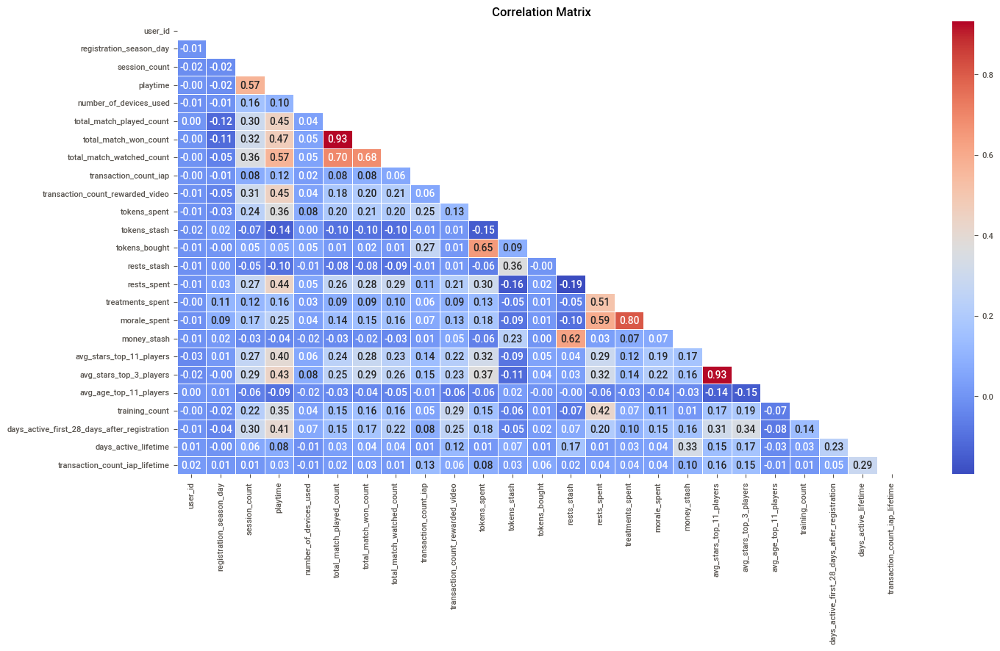

In [545]:
# Correlation Analysis
correlation_matrix = training_data[numeric_columns_training].corr()
plt.figure(figsize=(16, 8))
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))
sns.heatmap(correlation_matrix, annot=True, mask=mask, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

In [546]:
# Identify key correlated pairs (threshold > 0.7 for strong correlation)
correlation_threshold = 0.7
key_correlated_pairs = []

# Iterate over the correlation matrix and find pairs above the threshold
for i in range(correlation_matrix.shape[0]):
    for j in range(i + 1, correlation_matrix.shape[1]):
        if abs(correlation_matrix.iloc[i, j]) > correlation_threshold:
            feature_1 = correlation_matrix.index[i]
            feature_2 = correlation_matrix.columns[j]
            correlation_value = correlation_matrix.iloc[i, j]
            key_correlated_pairs.append((feature_1, feature_2, correlation_value))

# Convert to DataFrame for better readability and display
key_correlated_pairs_df = pd.DataFrame(key_correlated_pairs, columns=["Feature 1", "Feature 2", "Correlation"])
key_correlated_pairs_df = key_correlated_pairs_df.sort_values(by="Correlation", ascending=False).reset_index(drop=True)

key_correlated_pairs_df

,Feature 1,Feature 2,Correlation
0,total_match_played_count,total_match_won_count,0.930722
1,avg_stars_top_11_players,avg_stars_top_3_players,0.925473
2,treatments_spent,morale_spent,0.804064


- The analysis identified three strongly correlated feature pairs with a correlation threshold of 0.7, which indicates a strong linear relationship.
- There is a very strong positive correlation (0.93) between the total number of matches played and the total number of matches won. This makes sense logically: as users play more matches, they have more opportunities to win, resulting in a high correlation between these two features.
- The average stars of the top 11 players and the average stars of the top 3 players are also highly correlated (0.93). This is expected because the top 3 players contribute significantly to the average quality of the top 11 players.
- There is a strong positive correlation (0.80) between the amount of treatments spent and the amount of morale spent. This suggests that users who spend a lot on treatments also tend to spend a lot on morale, possibly indicating an active or aggressive playing style.
- We will investigate more on this to reduce multicollinearity that can help improve the stability and interpretability of the model, especially for linear models and models sensitive to correlated features (e.g., Lasso Regression).

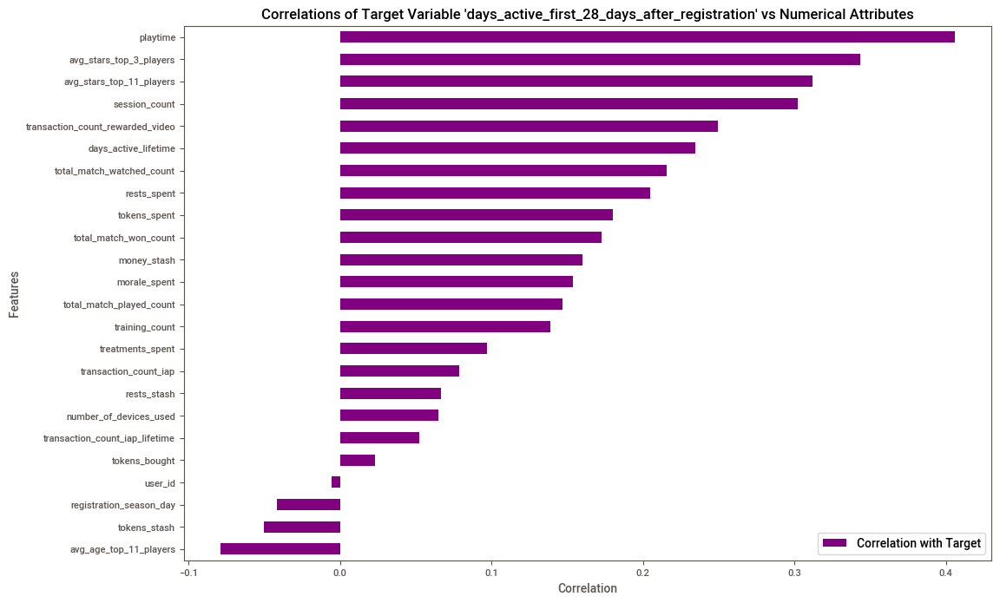

In [547]:
# Extract correlation values between each feature and the target variable 'days_active_first_28_days_after_registration'
target_correlation = correlation_matrix['days_active_first_28_days_after_registration'].drop('days_active_first_28_days_after_registration')

# Sort correlations by absolute value to see the strongest correlations at the top
target_correlation_sorted = target_correlation.sort_values(ascending=True).to_frame(name='Correlation with Target')

# Plotting the correlations
target_correlation_sorted.plot(kind='barh', figsize=(12,8), color='purple')
plt.title("Correlations of Target Variable 'days_active_first_28_days_after_registration' vs Numerical Attributes")
plt.xlabel("Correlation")
plt.ylabel("Features")
plt.show()

By focusing on features with stronger correlations, we can enhance the model’s predictive power and reduce noise in the data.

In [548]:
# Select only numeric features
numeric_features = training_data.select_dtypes(include=['float64', 'int64']).columns

# Standardize the data for better VIF calculations
scaler = StandardScaler()
scaled_data = scaler.fit_transform(training_data[numeric_features])

# Calculate VIF for each feature
vif_data = pd.DataFrame()
vif_data['Feature'] = numeric_features
vif_data['VIF'] = [variance_inflation_factor(scaled_data, i) for i in range(scaled_data.shape[1])]

# Display features with VIF scores
vif_data.sort_values(by="VIF", ascending=False)

,Feature,VIF
5,total_match_played_count,8.028945
19,avg_stars_top_3_players,7.925343
6,total_match_won_count,7.859023
18,avg_stars_top_11_players,7.198259
16,morale_spent,3.328535
15,treatments_spent,2.919539
10,tokens_spent,2.718079
3,playtime,2.714200
7,total_match_watched_count,2.359985
14,rests_spent,2.307109


- The Variance Inflation Factor (VIF) helps us understand multicollinearity in the dataset, which is a situation where two or more features are highly correlated. High multicollinearity can negatively impact the model's interpretability and stability, especially for linear models.
-  Features with High VIF (> 5):
        - total_match_played_count (VIF = 8.03)
        - avg_stars_top_3_players (VIF = 7.93)
        - total_match_won_count (VIF = 7.86)
        - avg_stars_top_11_players (VIF = 7.20)
These features exhibit moderate to high multicollinearity. Here are the possible reasons and actions:

- total_match_played_count and total_match_won_count:

Reason: These features are highly correlated (correlation = 0.93), as winning more matches typically requires playing more matches.

- avg_stars_top_3_players and avg_stars_top_11_players:

Reason: These features are also highly correlated (correlation = 0.93). Both represent player quality but for different subsets.

In [549]:
target_correlation_sorted.sort_values(by="Correlation with Target", ascending=False)

,Correlation with Target
playtime,0.405866
avg_stars_top_3_players,0.343371
avg_stars_top_11_players,0.312195
session_count,0.302213
transaction_count_rewarded_video,0.249702
days_active_lifetime,0.234768
total_match_watched_count,0.215645
rests_spent,0.204557
tokens_spent,0.180192
total_match_won_count,0.172427


Based on the analysis of multicollinearity, correlations, and VIF results, the decided to drop the following features:

- total_match_won_count:
High correlation with total_match_played_count (correlation = 0.93).
- avg_stars_top_11_players:
High correlation with avg_stars_top_3_players (correlation = 0.93).
- treatments_spent:
Moderate multicollinearity with morale_spent (VIF = 2.92) and a low correlation with the target variable.

In [550]:
# Drop 'total_match_won_count', 'avg_stars_top_11_players' and'treatments_spent' as they were identified as redundant
training_data = training_data.drop(['total_match_won_count', 'avg_stars_top_11_players', 'treatments_spent'], axis=1)

# Verify the features were dropped successfully
print("Remaining columns:", training_data.columns)

Remaining columns: Index(['user_id', 'registration_time_utc', 'registration_platform_specific',
       'registration_store', 'registration_season_day',
       'registration_channel_detailed', 'registration_device_type',
       'registration_device_manufacturer', 'session_count', 'playtime',
       'number_of_devices_used', 'total_match_played_count',
       'total_match_watched_count', 'transaction_count_iap',
       'transaction_count_rewarded_video', 'tokens_spent', 'tokens_stash',
       'tokens_bought', 'rests_stash', 'rests_spent', 'morale_spent',
       'money_stash', 'avg_stars_top_3_players', 'avg_age_top_11_players',
       'training_count', 'days_active_first_28_days_after_registration',
       'is_payer_lifetime', 'days_active_lifetime',
       'transaction_count_iap_lifetime', 'is_rewarded_video_watcher_lifetime',
       'continent'],
      dtype='object')


In [551]:
numeric_columns_training = training_data.select_dtypes(include=['int64', 'float64']).columns.tolist()

In [552]:
# Calculate the IQR for each numerical column
Q1 = training_data[numeric_columns_training].quantile(0.25)
Q3 = training_data[numeric_columns_training].quantile(0.75)
IQR = Q3 - Q1

# Define lower and upper bounds for outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Identify potential outliers
outliers = ((training_data[numeric_columns_training] < lower_bound) | (training_data[numeric_columns_training] > upper_bound)).any(axis=1)
outliers.value_counts()

True     28567
False    21433
dtype: int64

In [553]:
# Calculate percentage of outliers for each numerical column in the training dataset
outlier_percentage = {}

# Calculate IQR, bounds, and outlier percentage per column
for col in numeric_columns_training:
    Q1 = training_data[col].quantile(0.25)
    Q3 = training_data[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers = ((training_data[col] < lower_bound) | (training_data[col] > upper_bound))
    outlier_percentage[col] = (outliers.sum() / len(training_data)) * 100

# Convert to a DataFrame for easier viewing
outlier_percentage_df = pd.DataFrame(list(outlier_percentage.items()), columns=['Column', 'Outlier Percentage'])
outlier_percentage_df

,Column,Outlier Percentage
0,user_id,0.000
1,registration_season_day,0.000
2,session_count,4.272
3,playtime,5.928
4,number_of_devices_used,1.248
5,total_match_played_count,7.386
6,total_match_watched_count,21.432
7,transaction_count_iap,1.110
8,transaction_count_rewarded_video,15.076
9,tokens_spent,1.206


- From the analysis of outliers, we identified several columns with significant percentages of outlier values. However, after careful consideration, the decision was made to retain these outliers. 
- Some features, such as total_match_watched_count, transaction_count_rewarded_video, and transaction_count_iap_lifetime, have high outlier percentages. These outliers likely represent highly engaged users or users with unusual but valid gaming behavior.
- By retaining these outliers, we preserve the integrity of the data and maintain a realistic representation of user behavior.
- Additionally, retaining outliers allows the model to learn from the full range of user behaviors.

In [554]:
# Export the merged training and test datasets to CSV
training_data.to_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\processed\merged_training_data.csv", index=False)
test_data.to_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\processed\merged_test_data.csv", index=False)

# 6. Exploratory Data Analysis (EDA)

In [555]:
# Use the power of ydata_profiling library to understand our training data
profile = ProfileReport(training_data, title="Profiling Report")
profile.to_notebook_iframe()
profile.to_file(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\docs\ydata_training_data.html")
profile.to_file(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\docs\ydata_training_data.json")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Render JSON:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

                                             |          | [  0%]   00:00 -> (? left)

Report C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\docs\sweetviz_training_data.html was generated! NOTEBOOK/COLAB USERS: the web browser MAY not pop up, regardless, the report IS saved in your notebook/colab files.



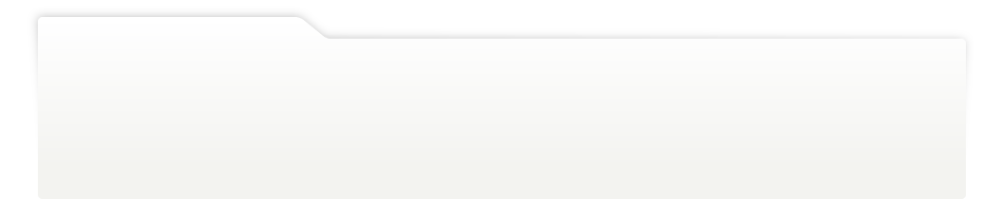
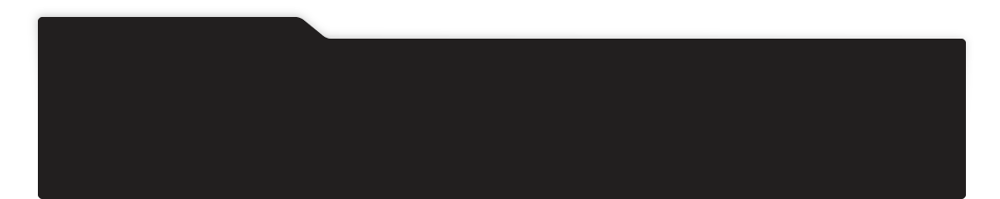
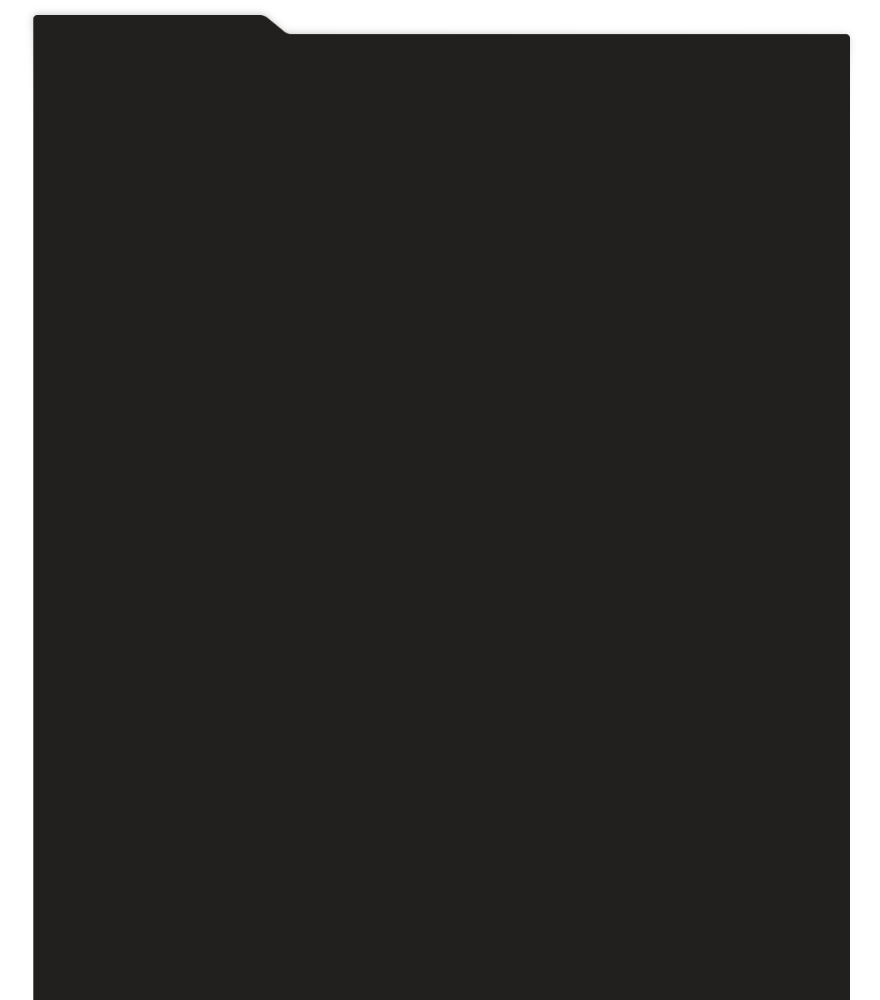
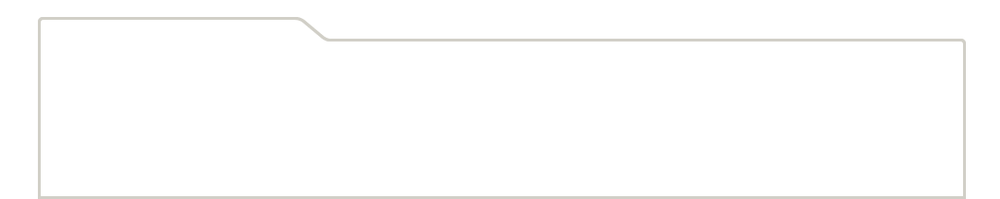
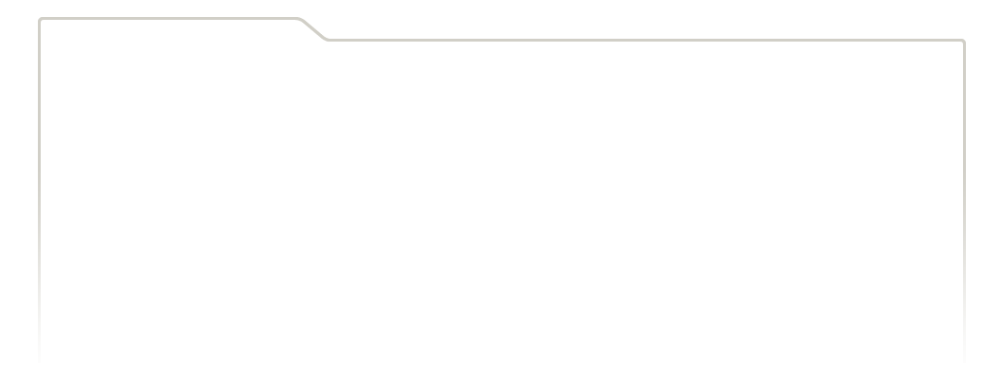
...
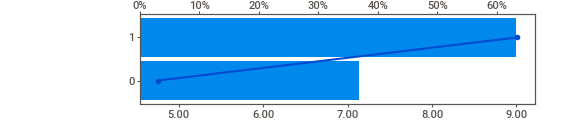
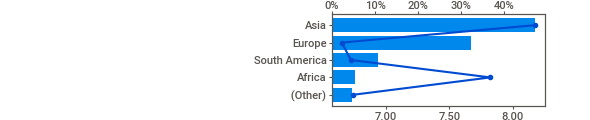
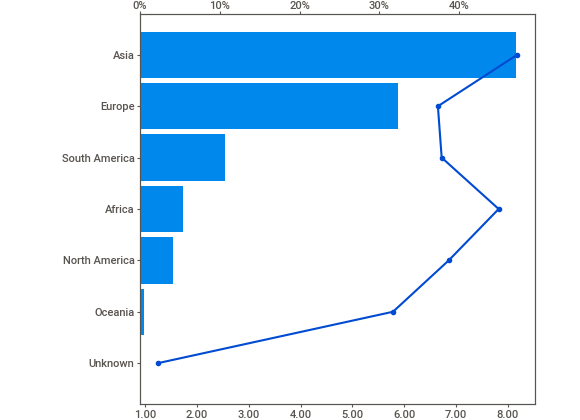
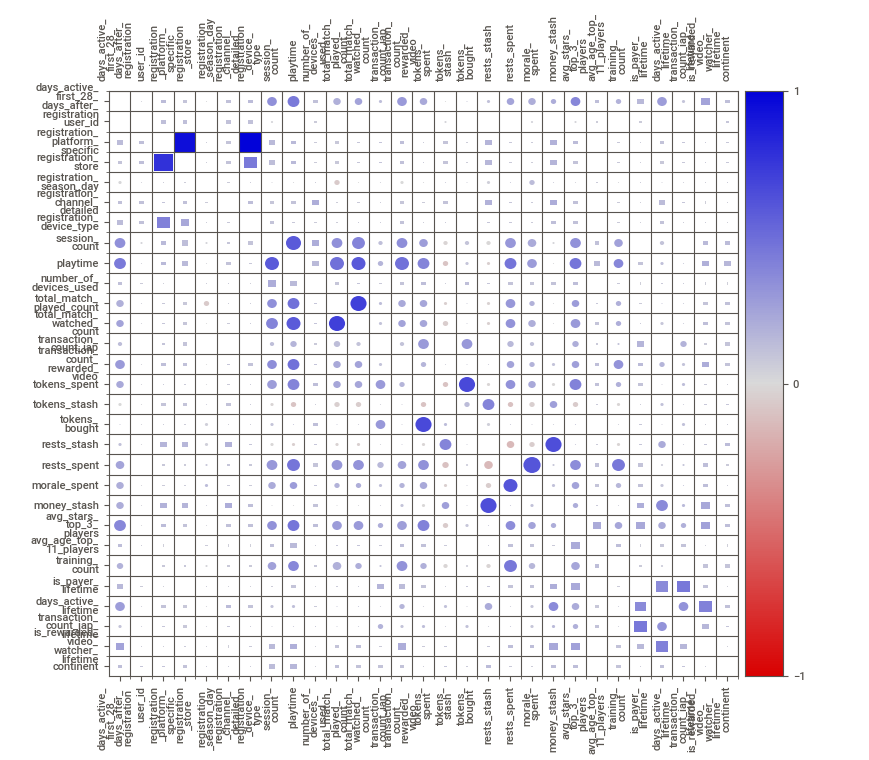
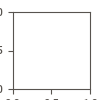

In [556]:
# Use the power of sweetviz library to understand our training data in relevance to the target variable
my_report = sv.analyze(training_data, target_feat='days_active_first_28_days_after_registration')
my_report.show_html(r'C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\docs\sweetviz_training_data.html')

my_report.show_notebook(w=None,
                h=None,
                scale=None,
                layout='widescreen',
                filepath=None)

In [557]:
# Identify categorical columns for encoding
categorical_columns = training_data.select_dtypes(include=['object']).columns.tolist()
categorical_columns

['registration_platform_specific',
 'registration_store',
 'registration_channel_detailed',
 'registration_device_type',
 'registration_device_manufacturer',
 'continent']

# 7. Data Encoding and Scaling

In [558]:
# Classify columns based on unique value counts
one_hot_cols = [col for col in categorical_columns if training_data[col].nunique() <= 5]
freq_encode_cols = [col for col in categorical_columns if training_data[col].nunique() > 5]

one_hot_cols, freq_encode_cols

(['registration_channel_detailed', 'registration_device_type'],
 ['registration_platform_specific',
  'registration_store',
  'registration_device_manufacturer',
  'continent'])

In [559]:
# Apply One-Hot Encoding for columns with few unique categories
training_data = pd.get_dummies(training_data, columns=one_hot_cols, drop_first=True)

# Apply Frequency Encoding for high-cardinality columns
for col in freq_encode_cols:
    freq_encoding = training_data[col].value_counts() / len(training_data)
    training_data[col] = training_data[col].map(freq_encoding)

In [560]:
# Convert boolean columns from one-hot encoding to integers
bool_columns = training_data.select_dtypes(include=['bool']).columns
training_data[bool_columns] = training_data[bool_columns].astype(int)

In [561]:
training_data.head().T

,0,1,2,3,4
user_id,5,7,13,23,25
registration_time_utc,2024-05-25 01:26:48,2024-06-14 20:09:31,2024-05-31 09:06:51,2024-05-31 04:00:33,2024-06-15 19:56:05
registration_platform_specific,0.2179,0.69598,0.69598,0.69598,0.2179
registration_store,0.24408,0.72034,0.72034,0.72034,0.24408
registration_season_day,7,27,13,13,28
registration_device_manufacturer,0.24136,0.1937,0.1937,0.06238,0.24136
session_count,1,1,2,4,5
playtime,2.351033,8.6959,28.386383,53.028333,97.782017
number_of_devices_used,1,1,1,1,1
total_match_played_count,2,0,0,3,1


In [562]:
# Save the encoded dataset
training_data.to_csv(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\processed\encoded_training_data.csv", index=False)

In [563]:
# Define the target and features
X = training_data.drop(columns=['days_active_first_28_days_after_registration'], errors='ignore')
y = training_data['days_active_first_28_days_after_registration']

# Remove datetime columns from the feature set
X = X.select_dtypes(exclude=['datetime64[ns]'])

# Split the data with shuffling enabled for feature selection
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42, shuffle=True)

# Initialize the Random Forest Regressor using only the training set
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train)

# Get feature importance from the Random Forest model trained on the training set
feature_importances = pd.DataFrame({
    'Feature': X_train.columns,
    'Importance': rf_model.feature_importances_
}).sort_values(by='Importance', ascending=False)

# Initialize RFE with the Random Forest model as the estimator, using only the training set
rfe_selector = RFE(estimator=rf_model, n_features_to_select=20, step=1)
rfe_selector.fit(X_train, y_train)

# Get the ranking of features from RFE
rfe_features = pd.DataFrame({
    'Feature': X_train.columns,
    'RFE_Ranking': rfe_selector.ranking_
}).sort_values(by='RFE_Ranking')

# Merge feature importance and RFE rankings for comparison
feature_selection_summary = pd.merge(feature_importances, rfe_features, on='Feature')

# Select features with RFE rank 1 and high importance
selected_features = feature_selection_summary[
    (feature_selection_summary['RFE_Ranking'] == 1) &
    (feature_selection_summary['Importance'] > feature_selection_summary['Importance'].mean())
]['Feature'].tolist()

print("Selected Features:", selected_features)

Selected Features: ['playtime', 'days_active_lifetime', 'money_stash', 'user_id', 'rests_stash', 'avg_stars_top_3_players', 'tokens_stash', 'registration_season_day', 'tokens_spent']


In [564]:
# Set the tracking URI
mlflow.set_tracking_uri("file:/C:/Users/User/Projects_for_Competitions_Companies/Nordeus_Data_Science_Challenge_2024/logs")

# Set the experiment name
mlflow.set_experiment("Nordeus_Data_Science_Challenge")

<Experiment: artifact_location='file:///C:/Users/User/Projects_for_Competitions_Companies/Nordeus_Data_Science_Challenge_2024/logs/1', creation_time=1731536452062, experiment_id='1', last_update_time=1731536452062, lifecycle_stage='active', name='Nordeus_Data_Science_Challenge', tags={}>

# 8. Train-Test Split

In [565]:
# Define the the target variable
target_variable = 'days_active_first_28_days_after_registration'

# Split the training data into train and validation sets
X = training_data[selected_features]
y = training_data[target_variable]

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

# Convert target variables to NumPy arrays
y_train = y_train.to_numpy()
y_val = y_val.to_numpy()

# Log the split data information
print("Train set size:", X_train.shape, "Validation set size:", X_val.shape)

Train set size: (40000, 9) Validation set size: (10000, 9)


In [566]:
# Exclude 'user_id' before scaling
X_train_features = X_train.drop(columns=['user_id'])
X_val_features = X_val.drop(columns=['user_id'])

# Initialize StandardScaler
scaler = StandardScaler()

# Fit the scaler on the training features and transform both training and validation sets
X_train_scaled = scaler.fit_transform(X_train_features)
X_val_scaled = scaler.transform(X_val_features)

In [567]:
# Directory path for saving the scaler
processed_data_dir = r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\processed"

# Save the fitted StandardScaler
scaler_path = os.path.join(processed_data_dir, 'scaler.pkl')
joblib.dump(scaler, scaler_path)
print(f"Scaler saved at: {scaler_path}")

Scaler saved at: C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\processed\scaler.pkl


In [568]:
# Directory path for processed data
processed_data_dir = r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\data\processed"

# Save the scaled training data
with open(os.path.join(processed_data_dir, 'X_train_scaled.pkl'), 'wb') as f:
    pickle.dump(X_train_scaled, f)

# Save the scaled validation data
with open(os.path.join(processed_data_dir, 'X_val_scaled.pkl'), 'wb') as f:
    pickle.dump(X_val_scaled, f)

# 9. Model Training and Evaluation

In [569]:
# Define a dictionary to store model performance
model_results = {}

# Define a helper function to evaluate and log models
def evaluate_model(model, model_name):
    with mlflow.start_run(run_name=model_name):
        # Cross-validate the model
        cv_mae = -cross_val_score(model, X_train_scaled, y_train, cv=5, scoring='neg_mean_absolute_error').mean()

        # Log metrics
        mlflow.log_param("model_name", model_name)
        mlflow.log_metric("MAE", cv_mae)

        # Store results
        model_results[model_name] = {"MAE": cv_mae}

        # Log the model with input example
        mlflow.sklearn.log_model(model, model_name)

    print(f"{model_name}: MAE = {cv_mae:.4f}")

# 1. Linear Regression
linear_model = LinearRegression()
evaluate_model(linear_model, "Linear_Regression")

# 2. Ridge Regression
ridge_model = Ridge(alpha=1.0)
evaluate_model(ridge_model, "Ridge_Regression")

# 3. Lasso Regression
lasso_model = Lasso(alpha=0.1)
evaluate_model(lasso_model, "Lasso_Regression")

# 4. Random Forest Regressor
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
evaluate_model(rf_model, "Random_Forest")

# 5. XGBoost Regressor
xgb_model = xgb.XGBRegressor(n_estimators=100, random_state=42)
evaluate_model(xgb_model, "XGBoost")

# 6. LightGBM Regressor
lgb_model = lgb.LGBMRegressor(n_estimators=100, random_state=42, force_row_wise=True)
evaluate_model(lgb_model, "LightGBM")

# 7. Initialize the Gradient Boosting Regressor
gbr_model = GradientBoostingRegressor(n_estimators=100, random_state=42)
evaluate_model(gbr_model, "Gradient_Boosting")

Linear_Regression: MAE = 6.5610
Ridge_Regression: MAE = 6.5610
Lasso_Regression: MAE = 6.5955
Random_Forest: MAE = 6.1504
XGBoost: MAE = 6.0082
LightGBM: MAE = 5.9526
Gradient_Boosting: MAE = 5.9890


In [570]:
# Define base models for ensemble methods
base_models = [
    ("Random_Forest", rf_model),
    ("XGBoost", xgb_model),
    ("LightGBM", lgb_model),
    ("Gradient_Boosting", gbr_model)
]

# 8. Voting Regressor (Ensemble of Tree-Based Models)
voting_regressor = VotingRegressor(estimators=base_models)
evaluate_model(voting_regressor, "Voting_Regressor")

# 9. Stacking Regressor (Ensemble of Tree-Based Models and Linear Regression)
stacking_regressor = StackingRegressor(
    estimators=base_models,
    final_estimator=LinearRegression()
)
evaluate_model(stacking_regressor, "Stacking_Regressor")

Voting_Regressor: MAE = 5.9866


2024/11/17 18:20:36 WARNING mlflow.sklearn: Model was missing function: predict. Not logging python_function flavor!


Stacking_Regressor: MAE = 5.9608


In [571]:
# Display the updated model results after ensemble model training
model_results

{'Linear_Regression': {'MAE': 6.560995731523204},
 'Ridge_Regression': {'MAE': 6.561017369731735},
 'Lasso_Regression': {'MAE': 6.595491936751841},
 'Random_Forest': {'MAE': 6.150380499999999},
 'XGBoost': {'MAE': 6.008153265736001},
 'LightGBM': {'MAE': 5.952608817970146},
 'Gradient_Boosting': {'MAE': 5.989033287423193},
 'Voting_Regressor': {'MAE': 5.986576310376134},
 'Stacking_Regressor': {'MAE': 5.96076739158368}}

# 10. Deep Learning Model

In [572]:
# Define a helper function to evaluate deep learning models
def evaluate_dl_model(model, model_name, X_train, y_train, X_val, y_val):
    with mlflow.start_run(run_name=model_name):
        # Compile the model
        model.compile(optimizer=Adam(learning_rate=0.001), loss='mean_absolute_error')

        # Train the model
        history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=50, batch_size=32, verbose=0)

        # Make predictions on the validation set
        y_pred = model.predict(X_val)

        # Calculate metrics
        mae = mean_absolute_error(y_val, y_pred)

        # Log metrics to MLflow
        mlflow.log_param("model_name", model_name)
        mlflow.log_metric("MAE", mae)

        # Log the model
        mlflow.keras.log_model(model, model_name)

        print(f"{model_name}: MAE = {mae:.4f}")

# Define a Feedforward Neural Network model
def build_ffnn(input_dim):
    model = Sequential([
        Input(shape=(input_dim,)),
        Dense(128, activation='relu'),
        Dropout(0.3),
        Dense(64, activation='relu'),
        Dropout(0.3),
        Dense(32, activation='relu'),
        Dense(1)
    ])
    return model

# Build and evaluate the Feedforward Neural Network model
input_dim = X_train_scaled.shape[1]
ffnn_model = build_ffnn(input_dim)
evaluate_dl_model(ffnn_model, "Feedforward_Neural_Network", X_train_scaled, y_train, X_val_scaled, y_val)

INFO:tensorflow:Assets written to: C:\Users\User\AppData\Local\Temp\tmpimei0uqq\model\data\model\assets
Feedforward_Neural_Network: MAE = 5.4542


**Best Model: Feedforward Neural Network (FFNN)**

- The FFNN achieved the lowest MAE (5.45), outperforming all other models.
- This result indicates that the deep learning model is better at capturing complex non-linear relationships in the data, likely due to the presence of non-linearity and interactions among features.

***Top Tree-Based Models:***

- LightGBM performed the best among the tree-based models, achieving an MAE of 5.95.
- XGBoost and Gradient Boosting had similar performance but were slightly worse than LightGBM.
- The Stacking Regressor (an ensemble model combining multiple base models) performed almost as well as LightGBM, indicating the benefit of leveraging multiple models together.

***Linear Models:***

- Linear Regression, Ridge, and Lasso showed significantly higher MAE values (~6.56), indicating that the relationships in the data are non-linear and not well captured by simple linear models.

**Key Takeaways:**
- The Feedforward Neural Network (FFNN) is the best-performing model in this scenario. It achieved the lowest MAE, demonstrating the model's ability to learn complex patterns in the data.
- Among the traditional machine learning models, LightGBM performed the best and provides better interpretability through feature importance and SHAP values.
- Given that the FFNN model achieved the best performance, we should use it for making predictions on the test data.
- Since the FFNN model lacks interpretability, we can still leverage the LightGBM model for feature importance and SHAP analysis to gain insights into the key drivers of the predictions.

# 11. Hyperparameter Tuning with Optuna

In [573]:
# Define an objective function for the Feedforward Neural Network
def objective_ffnn(trial):
    # Hyperparameter suggestions
    n_layers = trial.suggest_int("n_layers", 2, 4)
    n_neurons = trial.suggest_int("n_neurons", 32, 256)
    dropout_rate = trial.suggest_float("dropout_rate", 0.1, 0.5)
    learning_rate = trial.suggest_float("learning_rate", 1e-5, 1e-2)
    epochs = trial.suggest_int("epochs", 20, 100)
    batch_size = trial.suggest_int("batch_size", 16, 64)
    patience = trial.suggest_int("patience", 5, 20)
    
    # Build the model
    model = Sequential()
    model.add(Input(shape=(X_train_scaled.shape[1],)))
    model.add(Dense(n_neurons, activation='relu'))
    model.add(Dropout(dropout_rate))
    for _ in range(n_layers - 1):
        model.add(Dense(n_neurons, activation='relu'))
        model.add(Dropout(dropout_rate))
    model.add(Dense(1))  # Output layer

    # Compile the model
    optimizer = Adam(learning_rate=learning_rate)
    model.compile(optimizer=optimizer, loss='mean_absolute_error')
    
    # Define the EarlyStopping callback
    early_stopping = EarlyStopping(
        monitor='val_loss',
        patience=patience,
        restore_best_weights=True,
        verbose=1
    )

    # Train the model
    history = model.fit(X_train_scaled, y_train, validation_data=(X_val_scaled, y_val),
                        epochs=epochs, batch_size=batch_size, callbacks=[early_stopping], verbose=0)

    # Evaluate the model
    y_pred = model.predict(X_val_scaled).flatten()
    mae = mean_absolute_error(y_val, y_pred)

    return mae

In [574]:
# Define the objective function for LightGBM tuning
def objective_lgb(trial):
    param = {
        "n_estimators": trial.suggest_int("n_estimators", 200, 1200),
        "learning_rate": trial.suggest_float("learning_rate", 0.005, 0.05),
        "num_leaves": trial.suggest_int("num_leaves", 20, 150),
        "max_depth": trial.suggest_int("max_depth", 3, 15),
        "min_child_samples": trial.suggest_int("min_child_samples", 10, 40),
        "min_gain_to_split": trial.suggest_float("min_gain_to_split", 0.01, 0.1),
        "subsample": trial.suggest_float("subsample", 0.6, 0.9),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.6, 0.9),
        "lambda_l1": trial.suggest_float("lambda_l1", 0.0, 10.0),
        "lambda_l2": trial.suggest_float("lambda_l2", 0.0, 10.0),
        "random_state": 42,
        "force_row_wise": True,
        "verbosity": -1,
    }

    # Initialize and train the model
    model = lgb.LGBMRegressor(**param)
    model.fit(
      X_train, y_train,
      eval_set=[(X_val, y_val)],
      callbacks=[lgb.early_stopping(stopping_rounds=100), lgb.log_evaluation(-1)]
    )

    # Predict and evaluate
    y_pred = model.predict(X_val)
    mae = mean_absolute_error(y_val, y_pred)

    return mae

In [575]:
# Initialize MLflow experiment
mlflow.set_experiment("Optuna_Hyperparameter_Tuning")

# Run Bayesian Optimization with Optuna for Feedforward Neural Network
sampler = optuna.samplers.RandomSampler()
ffnn_study = optuna.create_study(direction="minimize", sampler=sampler)
ffnn_study.optimize(objective_ffnn, n_trials=50)

# Log the best FFNN model parameters
mlflow.log_params(ffnn_study.best_params)
mlflow.log_metric("Best_MAE_FFNN", ffnn_study.best_value)

[I 2024-11-17 18:25:03,949] A new study created in memory with name: no-name-c6c9e0ac-ac0e-4db2-b2f8-da0400a00ce6


Restoring model weights from the end of the best epoch.
Epoch 00033: early stopping


[I 2024-11-17 18:27:40,879] Trial 0 finished with value: 5.433613474501016 and parameters: {'n_layers': 3, 'n_neurons': 127, 'dropout_rate': 0.16921203376021943, 'learning_rate': 0.0007280340496553273, 'epochs': 60, 'batch_size': 56, 'patience': 9}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00011: early stopping


[I 2024-11-17 18:28:51,111] Trial 1 finished with value: 5.47866722842278 and parameters: {'n_layers': 2, 'n_neurons': 174, 'dropout_rate': 0.21935611236617636, 'learning_rate': 0.00954169801400761, 'epochs': 42, 'batch_size': 33, 'patience': 6}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00027: early stopping


[I 2024-11-17 18:30:51,495] Trial 2 finished with value: 5.473156053098012 and parameters: {'n_layers': 2, 'n_neurons': 201, 'dropout_rate': 0.3510254447308624, 'learning_rate': 0.008177881867556516, 'epochs': 90, 'batch_size': 54, 'patience': 20}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00013: early stopping


[I 2024-11-17 18:32:05,810] Trial 3 finished with value: 5.5933470358750785 and parameters: {'n_layers': 4, 'n_neurons': 114, 'dropout_rate': 0.4291523072444917, 'learning_rate': 0.009492831228440064, 'epochs': 61, 'batch_size': 41, 'patience': 9}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00014: early stopping


[I 2024-11-17 18:33:46,277] Trial 4 finished with value: 5.495986469672178 and parameters: {'n_layers': 4, 'n_neurons': 101, 'dropout_rate': 0.4805780029734543, 'learning_rate': 0.002230308593922672, 'epochs': 63, 'batch_size': 27, 'patience': 5}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00023: early stopping


[I 2024-11-17 18:35:52,619] Trial 5 finished with value: 5.473979819388167 and parameters: {'n_layers': 4, 'n_neurons': 122, 'dropout_rate': 0.4021616526171269, 'learning_rate': 0.0027020182780869086, 'epochs': 23, 'batch_size': 47, 'patience': 14}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00016: early stopping


[I 2024-11-17 18:37:54,875] Trial 6 finished with value: 5.562529431228014 and parameters: {'n_layers': 4, 'n_neurons': 144, 'dropout_rate': 0.4244353013679585, 'learning_rate': 0.006155489915420044, 'epochs': 82, 'batch_size': 31, 'patience': 6}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00021: early stopping


[I 2024-11-17 18:39:41,624] Trial 7 finished with value: 5.460645952661795 and parameters: {'n_layers': 2, 'n_neurons': 209, 'dropout_rate': 0.3375122369545742, 'learning_rate': 0.004702733535730134, 'epochs': 53, 'batch_size': 46, 'patience': 12}. Best is trial 0 with value: 5.433613474501016.
[I 2024-11-17 18:41:46,482] Trial 8 finished with value: 5.556561127971439 and parameters: {'n_layers': 3, 'n_neurons': 45, 'dropout_rate': 0.47456625336410274, 'learning_rate': 0.004178772287783252, 'epochs': 30, 'batch_size': 34, 'patience': 19}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00041: early stopping


[I 2024-11-17 18:44:02,493] Trial 9 finished with value: 5.532457677214429 and parameters: {'n_layers': 4, 'n_neurons': 75, 'dropout_rate': 0.4768971322670613, 'learning_rate': 0.007862867215921462, 'epochs': 50, 'batch_size': 63, 'patience': 15}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00019: early stopping


[I 2024-11-17 18:47:44,636] Trial 10 finished with value: 5.626986183596403 and parameters: {'n_layers': 4, 'n_neurons': 163, 'dropout_rate': 0.39474617870617634, 'learning_rate': 0.007344377752240248, 'epochs': 29, 'batch_size': 16, 'patience': 15}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00052: early stopping


[I 2024-11-17 18:50:14,023] Trial 11 finished with value: 5.455292303194548 and parameters: {'n_layers': 2, 'n_neurons': 35, 'dropout_rate': 0.21103342974192968, 'learning_rate': 0.007006897807747683, 'epochs': 100, 'batch_size': 45, 'patience': 19}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00017: early stopping


[I 2024-11-17 18:52:00,021] Trial 12 finished with value: 5.497970778931165 and parameters: {'n_layers': 4, 'n_neurons': 174, 'dropout_rate': 0.20151912784891146, 'learning_rate': 0.00994481706284655, 'epochs': 23, 'batch_size': 60, 'patience': 8}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00021: early stopping


[I 2024-11-17 18:53:32,339] Trial 13 finished with value: 5.4862537862706 and parameters: {'n_layers': 2, 'n_neurons': 175, 'dropout_rate': 0.4188429688318006, 'learning_rate': 0.0059604410235764935, 'epochs': 100, 'batch_size': 43, 'patience': 16}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00022: early stopping


[I 2024-11-17 18:55:28,075] Trial 14 finished with value: 5.465335784415388 and parameters: {'n_layers': 2, 'n_neurons': 231, 'dropout_rate': 0.21435509625506508, 'learning_rate': 0.005902001234328772, 'epochs': 81, 'batch_size': 44, 'patience': 7}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00063: early stopping


[I 2024-11-17 19:01:33,022] Trial 15 finished with value: 5.455533098894972 and parameters: {'n_layers': 3, 'n_neurons': 201, 'dropout_rate': 0.4717459530911887, 'learning_rate': 0.0014764696052678961, 'epochs': 86, 'batch_size': 51, 'patience': 20}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00017: early stopping


[I 2024-11-17 19:03:54,062] Trial 16 finished with value: 5.454049990832897 and parameters: {'n_layers': 4, 'n_neurons': 123, 'dropout_rate': 0.10672801106569124, 'learning_rate': 0.0005425140635903549, 'epochs': 47, 'batch_size': 27, 'patience': 5}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00030: early stopping


[I 2024-11-17 19:05:40,910] Trial 17 finished with value: 5.4795265966520645 and parameters: {'n_layers': 3, 'n_neurons': 70, 'dropout_rate': 0.39806774867008343, 'learning_rate': 0.005806265134922271, 'epochs': 34, 'batch_size': 46, 'patience': 9}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00026: early stopping


[I 2024-11-17 19:07:27,981] Trial 18 finished with value: 5.462530097028544 and parameters: {'n_layers': 3, 'n_neurons': 130, 'dropout_rate': 0.3763729255114576, 'learning_rate': 0.0019392013202589808, 'epochs': 67, 'batch_size': 57, 'patience': 13}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00016: early stopping


[I 2024-11-17 19:08:31,017] Trial 19 finished with value: 5.506006028568 and parameters: {'n_layers': 4, 'n_neurons': 96, 'dropout_rate': 0.2613532548377658, 'learning_rate': 0.009494896880281985, 'epochs': 35, 'batch_size': 60, 'patience': 15}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00015: early stopping


[I 2024-11-17 19:09:30,378] Trial 20 finished with value: 5.461808730485931 and parameters: {'n_layers': 2, 'n_neurons': 88, 'dropout_rate': 0.32405518218647816, 'learning_rate': 0.0029392880178102506, 'epochs': 83, 'batch_size': 37, 'patience': 10}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00024: early stopping


[I 2024-11-17 19:14:41,083] Trial 21 finished with value: 5.65843569858484 and parameters: {'n_layers': 4, 'n_neurons': 212, 'dropout_rate': 0.29257468526447444, 'learning_rate': 0.008298396225489125, 'epochs': 66, 'batch_size': 16, 'patience': 20}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00015: early stopping


[I 2024-11-17 19:15:40,874] Trial 22 finished with value: 5.457728911678411 and parameters: {'n_layers': 2, 'n_neurons': 99, 'dropout_rate': 0.23832942783069463, 'learning_rate': 0.0048002653079740965, 'epochs': 61, 'batch_size': 49, 'patience': 7}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00017: early stopping


[I 2024-11-17 19:16:46,976] Trial 23 finished with value: 5.470535868057422 and parameters: {'n_layers': 2, 'n_neurons': 167, 'dropout_rate': 0.2411732409215436, 'learning_rate': 0.005264027506053618, 'epochs': 62, 'batch_size': 55, 'patience': 16}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00026: early stopping


[I 2024-11-17 19:19:26,075] Trial 24 finished with value: 5.463831494600838 and parameters: {'n_layers': 4, 'n_neurons': 84, 'dropout_rate': 0.2587803400416076, 'learning_rate': 0.004383571823767782, 'epochs': 53, 'batch_size': 25, 'patience': 19}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00015: early stopping


[I 2024-11-17 19:21:14,007] Trial 25 finished with value: 5.4804991960605145 and parameters: {'n_layers': 4, 'n_neurons': 161, 'dropout_rate': 0.127520414303034, 'learning_rate': 0.007985735040489782, 'epochs': 80, 'batch_size': 39, 'patience': 10}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00029: early stopping


[I 2024-11-17 19:23:24,936] Trial 26 finished with value: 5.462266073192423 and parameters: {'n_layers': 2, 'n_neurons': 245, 'dropout_rate': 0.25107540339253887, 'learning_rate': 0.008205106670127854, 'epochs': 54, 'batch_size': 54, 'patience': 17}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00012: early stopping


[I 2024-11-17 19:24:29,175] Trial 27 finished with value: 5.480347851745412 and parameters: {'n_layers': 2, 'n_neurons': 249, 'dropout_rate': 0.177354164261042, 'learning_rate': 0.006894073820717716, 'epochs': 57, 'batch_size': 47, 'patience': 5}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00028: early stopping


[I 2024-11-17 19:26:37,424] Trial 28 finished with value: 5.4654011127947655 and parameters: {'n_layers': 2, 'n_neurons': 180, 'dropout_rate': 0.42330085315234667, 'learning_rate': 0.0019144598783951304, 'epochs': 77, 'batch_size': 42, 'patience': 11}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00022: early stopping


[I 2024-11-17 19:29:32,234] Trial 29 finished with value: 5.568510553766281 and parameters: {'n_layers': 3, 'n_neurons': 195, 'dropout_rate': 0.4938624570249278, 'learning_rate': 0.009119406596245615, 'epochs': 71, 'batch_size': 25, 'patience': 6}. Best is trial 0 with value: 5.433613474501016.
[I 2024-11-17 19:31:34,117] Trial 30 finished with value: 5.507628094593529 and parameters: {'n_layers': 2, 'n_neurons': 252, 'dropout_rate': 0.4104262123538772, 'learning_rate': 0.009480724493808563, 'epochs': 25, 'batch_size': 52, 'patience': 20}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00066: early stopping


[I 2024-11-17 19:35:25,068] Trial 31 finished with value: 5.451825429341009 and parameters: {'n_layers': 2, 'n_neurons': 107, 'dropout_rate': 0.3841290350205985, 'learning_rate': 0.00027827635282673424, 'epochs': 73, 'batch_size': 45, 'patience': 16}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00021: early stopping


[I 2024-11-17 19:37:08,260] Trial 32 finished with value: 5.63471738352729 and parameters: {'n_layers': 4, 'n_neurons': 129, 'dropout_rate': 0.48139323629460784, 'learning_rate': 0.009620081305201466, 'epochs': 42, 'batch_size': 57, 'patience': 18}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00024: early stopping


[I 2024-11-17 19:40:09,121] Trial 33 finished with value: 5.517680092109414 and parameters: {'n_layers': 4, 'n_neurons': 143, 'dropout_rate': 0.3009673627629215, 'learning_rate': 0.00685091232439924, 'epochs': 36, 'batch_size': 33, 'patience': 17}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00025: early stopping


[I 2024-11-17 19:41:20,050] Trial 34 finished with value: 5.457420399006969 and parameters: {'n_layers': 2, 'n_neurons': 91, 'dropout_rate': 0.19161300853588156, 'learning_rate': 0.005908837619067638, 'epochs': 98, 'batch_size': 56, 'patience': 18}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00025: early stopping


[I 2024-11-17 19:44:29,165] Trial 35 finished with value: 5.490145565735269 and parameters: {'n_layers': 4, 'n_neurons': 77, 'dropout_rate': 0.2668770907919952, 'learning_rate': 0.004846133590110111, 'epochs': 29, 'batch_size': 21, 'patience': 19}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00014: early stopping


[I 2024-11-17 19:46:02,701] Trial 36 finished with value: 5.46908526335666 and parameters: {'n_layers': 4, 'n_neurons': 36, 'dropout_rate': 0.19047198617142716, 'learning_rate': 0.0036211424386428854, 'epochs': 93, 'batch_size': 20, 'patience': 5}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00036: early stopping


[I 2024-11-17 19:50:32,334] Trial 37 finished with value: 5.472951999710687 and parameters: {'n_layers': 3, 'n_neurons': 227, 'dropout_rate': 0.4044801587617445, 'learning_rate': 0.005661608620179868, 'epochs': 50, 'batch_size': 36, 'patience': 13}. Best is trial 0 with value: 5.433613474501016.
[I 2024-11-17 19:51:49,014] Trial 38 finished with value: 5.5248478460223875 and parameters: {'n_layers': 3, 'n_neurons': 110, 'dropout_rate': 0.18894823427050006, 'learning_rate': 0.003708807203201809, 'epochs': 21, 'batch_size': 57, 'patience': 14}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00025: early stopping


[I 2024-11-17 19:53:34,765] Trial 39 finished with value: 5.504450880849827 and parameters: {'n_layers': 3, 'n_neurons': 63, 'dropout_rate': 0.36134731962707456, 'learning_rate': 0.007368853151026743, 'epochs': 73, 'batch_size': 32, 'patience': 11}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00010: early stopping


[I 2024-11-17 19:54:48,903] Trial 40 finished with value: 5.474757613022579 and parameters: {'n_layers': 2, 'n_neurons': 255, 'dropout_rate': 0.12294741069814404, 'learning_rate': 0.0034081891536124763, 'epochs': 70, 'batch_size': 30, 'patience': 8}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00015: early stopping


[I 2024-11-17 19:55:59,019] Trial 41 finished with value: 5.505062904648832 and parameters: {'n_layers': 2, 'n_neurons': 215, 'dropout_rate': 0.3390948025746038, 'learning_rate': 0.008240335348158835, 'epochs': 74, 'batch_size': 48, 'patience': 8}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00026: early stopping


[I 2024-11-17 19:58:09,805] Trial 42 finished with value: 5.497934581831727 and parameters: {'n_layers': 3, 'n_neurons': 104, 'dropout_rate': 0.3536777314945003, 'learning_rate': 0.009471414231494535, 'epochs': 64, 'batch_size': 34, 'patience': 16}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00033: early stopping


[I 2024-11-17 20:00:18,042] Trial 43 finished with value: 5.466522309364227 and parameters: {'n_layers': 2, 'n_neurons': 139, 'dropout_rate': 0.3378709421661391, 'learning_rate': 0.003008507130168282, 'epochs': 64, 'batch_size': 47, 'patience': 17}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00018: early stopping


[I 2024-11-17 20:02:25,349] Trial 44 finished with value: 5.505612955376925 and parameters: {'n_layers': 3, 'n_neurons': 210, 'dropout_rate': 0.3514541529216384, 'learning_rate': 0.006961669703294187, 'epochs': 98, 'batch_size': 36, 'patience': 12}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00032: early stopping


[I 2024-11-17 20:07:15,651] Trial 45 finished with value: 5.45072240184299 and parameters: {'n_layers': 3, 'n_neurons': 226, 'dropout_rate': 0.19588072375601528, 'learning_rate': 8.202262286046261e-05, 'epochs': 43, 'batch_size': 28, 'patience': 10}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00013: early stopping


[I 2024-11-17 20:08:55,114] Trial 46 finished with value: 5.477820931095653 and parameters: {'n_layers': 4, 'n_neurons': 170, 'dropout_rate': 0.3996035479017154, 'learning_rate': 0.002104295378021627, 'epochs': 89, 'batch_size': 39, 'patience': 7}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00055: early stopping


[I 2024-11-17 20:12:56,802] Trial 47 finished with value: 5.5015380732327 and parameters: {'n_layers': 3, 'n_neurons': 65, 'dropout_rate': 0.3413265161873398, 'learning_rate': 0.009330751113911545, 'epochs': 61, 'batch_size': 34, 'patience': 20}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00026: early stopping


[I 2024-11-17 20:14:15,117] Trial 48 finished with value: 5.46712369954905 and parameters: {'n_layers': 2, 'n_neurons': 51, 'dropout_rate': 0.4851373998742047, 'learning_rate': 0.0028302893157860476, 'epochs': 47, 'batch_size': 48, 'patience': 7}. Best is trial 0 with value: 5.433613474501016.


Restoring model weights from the end of the best epoch.
Epoch 00013: early stopping


[I 2024-11-17 20:15:23,603] Trial 49 finished with value: 5.475194278530788 and parameters: {'n_layers': 2, 'n_neurons': 241, 'dropout_rate': 0.35397031586297056, 'learning_rate': 0.005650282041563864, 'epochs': 24, 'batch_size': 48, 'patience': 8}. Best is trial 0 with value: 5.433613474501016.


In [576]:
# Run Bayesian Optimization with Optuna for LightGBM model
sampler = optuna.samplers.RandomSampler()
lgb_study = optuna.create_study(direction="minimize", sampler=sampler)
lgb_study.optimize(objective_lgb, n_trials=100)

# Print the best parameters
print("Best MAE:", lgb_study.best_value)
print("Best parameters:", lgb_study.best_params)

[I 2024-11-17 20:15:24,286] A new study created in memory with name: no-name-02e5a0d6-ab79-4256-8d69-4af08b7269c7


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:15:26,522] Trial 0 finished with value: 6.010481196439204 and parameters: {'n_estimators': 748, 'learning_rate': 0.03727798521313961, 'num_leaves': 95, 'max_depth': 12, 'min_child_samples': 29, 'min_gain_to_split': 0.07424500632916792, 'subsample': 0.8849461352923131, 'colsample_bytree': 0.6940657661913431, 'lambda_l1': 2.871172789061581, 'lambda_l2': 1.131836304608722}. Best is trial 0 with value: 6.010481196439204.


Early stopping, best iteration is:
[89]	valid_0's l2: 63.4173
Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:15:29,862] Trial 1 finished with value: 5.978891890266421 and parameters: {'n_estimators': 210, 'learning_rate': 0.017755949237455812, 'num_leaves': 50, 'max_depth': 5, 'min_child_samples': 35, 'min_gain_to_split': 0.09757319191114633, 'subsample': 0.7063211033709025, 'colsample_bytree': 0.7617061498590355, 'lambda_l1': 7.347003657373633, 'lambda_l2': 9.586869676118168}. Best is trial 1 with value: 5.978891890266421.


Did not meet early stopping. Best iteration is:
[210]	valid_0's l2: 63.1955
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[195]	valid_0's l2: 63.1477


[I 2024-11-17 20:15:35,667] Trial 2 finished with value: 5.9198233166454655 and parameters: {'n_estimators': 481, 'learning_rate': 0.029907989816938516, 'num_leaves': 81, 'max_depth': 6, 'min_child_samples': 35, 'min_gain_to_split': 0.05086978337601956, 'subsample': 0.7836223505813777, 'colsample_bytree': 0.7707408871180994, 'lambda_l1': 9.917922333956842, 'lambda_l2': 2.0481698523405356}. Best is trial 2 with value: 5.9198233166454655.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[107]	valid_0's l2: 63.5059


[I 2024-11-17 20:15:39,920] Trial 3 finished with value: 6.002534893361445 and parameters: {'n_estimators': 227, 'learning_rate': 0.031356734221887145, 'num_leaves': 148, 'max_depth': 11, 'min_child_samples': 35, 'min_gain_to_split': 0.047675836397129814, 'subsample': 0.8108565840215661, 'colsample_bytree': 0.6925090103933881, 'lambda_l1': 1.3406370399594458, 'lambda_l2': 8.710615754077057}. Best is trial 2 with value: 5.9198233166454655.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[272]	valid_0's l2: 63.1597


[I 2024-11-17 20:15:44,854] Trial 4 finished with value: 5.931189912697235 and parameters: {'n_estimators': 903, 'learning_rate': 0.016923769687215748, 'num_leaves': 125, 'max_depth': 7, 'min_child_samples': 40, 'min_gain_to_split': 0.045661186267883076, 'subsample': 0.8723617916704411, 'colsample_bytree': 0.7285963961459119, 'lambda_l1': 2.13863039410806, 'lambda_l2': 5.311580294256312}. Best is trial 2 with value: 5.9198233166454655.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[728]	valid_0's l2: 62.7448


[I 2024-11-17 20:15:51,389] Trial 5 finished with value: 5.8939966183315775 and parameters: {'n_estimators': 970, 'learning_rate': 0.021281042473195556, 'num_leaves': 85, 'max_depth': 4, 'min_child_samples': 17, 'min_gain_to_split': 0.09075098348167021, 'subsample': 0.8891469112160637, 'colsample_bytree': 0.674110341609166, 'lambda_l1': 1.647696582118371, 'lambda_l2': 0.4351233978543312}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:15:54,027] Trial 6 finished with value: 5.976162783747739 and parameters: {'n_estimators': 926, 'learning_rate': 0.04309015943948875, 'num_leaves': 119, 'max_depth': 9, 'min_child_samples': 36, 'min_gain_to_split': 0.033521780917219246, 'subsample': 0.6399425263272088, 'colsample_bytree': 0.8114671105179482, 'lambda_l1': 8.548784302608373, 'lambda_l2': 2.0238415170972623}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[79]	valid_0's l2: 63.4568
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[204]	valid_0's l2: 63.2657


[I 2024-11-17 20:16:01,505] Trial 7 finished with value: 5.936414986512968 and parameters: {'n_estimators': 923, 'learning_rate': 0.021175387934287627, 'num_leaves': 134, 'max_depth': 8, 'min_child_samples': 27, 'min_gain_to_split': 0.06867616300093361, 'subsample': 0.7549177174919904, 'colsample_bytree': 0.7325996749655985, 'lambda_l1': 3.321861785813922, 'lambda_l2': 7.787471528678348}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[95]	valid_0's l2: 63.4127


[I 2024-11-17 20:16:06,127] Trial 8 finished with value: 5.997413161764338 and parameters: {'n_estimators': 624, 'learning_rate': 0.03521345168360611, 'num_leaves': 150, 'max_depth': 12, 'min_child_samples': 27, 'min_gain_to_split': 0.0660818655957054, 'subsample': 0.8226264100008078, 'colsample_bytree': 0.6750810616528136, 'lambda_l1': 6.454256774358851, 'lambda_l2': 4.645771514033977}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:16:09,023] Trial 9 finished with value: 5.961078084190766 and parameters: {'n_estimators': 968, 'learning_rate': 0.04641998696852803, 'num_leaves': 107, 'max_depth': 15, 'min_child_samples': 20, 'min_gain_to_split': 0.012522490612507785, 'subsample': 0.8107180439320603, 'colsample_bytree': 0.8036335646687315, 'lambda_l1': 4.475362043820735, 'lambda_l2': 4.912590929484326}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[81]	valid_0's l2: 63.4792
Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:16:12,643] Trial 10 finished with value: 5.901103423860357 and parameters: {'n_estimators': 1166, 'learning_rate': 0.04363156391572473, 'num_leaves': 33, 'max_depth': 10, 'min_child_samples': 18, 'min_gain_to_split': 0.09641150777126614, 'subsample': 0.6205140202120443, 'colsample_bytree': 0.7597384273027608, 'lambda_l1': 1.239920248492099, 'lambda_l2': 9.638780993144962}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[210]	valid_0's l2: 63.0712
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[184]	valid_0's l2: 63.4119


[I 2024-11-17 20:16:19,450] Trial 11 finished with value: 5.9491786404890235 and parameters: {'n_estimators': 985, 'learning_rate': 0.0203236169528716, 'num_leaves': 149, 'max_depth': 8, 'min_child_samples': 25, 'min_gain_to_split': 0.06177268533818542, 'subsample': 0.835984319497302, 'colsample_bytree': 0.8991172795199351, 'lambda_l1': 6.439330302476415, 'lambda_l2': 7.710815537090321}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[529]	valid_0's l2: 63.3607


[I 2024-11-17 20:16:31,345] Trial 12 finished with value: 5.968475041520697 and parameters: {'n_estimators': 797, 'learning_rate': 0.006728455696734187, 'num_leaves': 149, 'max_depth': 11, 'min_child_samples': 14, 'min_gain_to_split': 0.016457212397496448, 'subsample': 0.7910726264833292, 'colsample_bytree': 0.8201784036348003, 'lambda_l1': 8.356775660792918, 'lambda_l2': 5.353653345303629}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[139]	valid_0's l2: 63.2154


[I 2024-11-17 20:16:36,361] Trial 13 finished with value: 5.945343863086345 and parameters: {'n_estimators': 913, 'learning_rate': 0.03213510826096428, 'num_leaves': 80, 'max_depth': 11, 'min_child_samples': 15, 'min_gain_to_split': 0.022333098932963494, 'subsample': 0.7243822845120644, 'colsample_bytree': 0.651032938351428, 'lambda_l1': 8.617419176746395, 'lambda_l2': 3.0032146243068327}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:16:39,693] Trial 14 finished with value: 5.963882842218689 and parameters: {'n_estimators': 565, 'learning_rate': 0.044314536223779843, 'num_leaves': 77, 'max_depth': 13, 'min_child_samples': 38, 'min_gain_to_split': 0.06533013858837718, 'subsample': 0.6487537219896022, 'colsample_bytree': 0.6457174229364495, 'lambda_l1': 6.108355001950924, 'lambda_l2': 6.453857842877985}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[91]	valid_0's l2: 63.2998
Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:16:43,265] Trial 15 finished with value: 5.913294694950001 and parameters: {'n_estimators': 1155, 'learning_rate': 0.03944414862105885, 'num_leaves': 31, 'max_depth': 3, 'min_child_samples': 10, 'min_gain_to_split': 0.04185820233999056, 'subsample': 0.6966101855385279, 'colsample_bytree': 0.7362855714076036, 'lambda_l1': 8.956438554563125, 'lambda_l2': 6.727654321033331}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[416]	valid_0's l2: 62.8039
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[280]	valid_0's l2: 63.0536


[I 2024-11-17 20:16:47,749] Trial 16 finished with value: 5.911513181078717 and parameters: {'n_estimators': 1122, 'learning_rate': 0.02262878455721323, 'num_leaves': 108, 'max_depth': 6, 'min_child_samples': 27, 'min_gain_to_split': 0.07053945951054465, 'subsample': 0.8995283171656239, 'colsample_bytree': 0.7484174635946579, 'lambda_l1': 2.7053715695380944, 'lambda_l2': 8.58857749191956}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[291]	valid_0's l2: 63.1952


[I 2024-11-17 20:16:52,978] Trial 17 finished with value: 5.904761451859073 and parameters: {'n_estimators': 398, 'learning_rate': 0.02783446856857361, 'num_leaves': 39, 'max_depth': 8, 'min_child_samples': 30, 'min_gain_to_split': 0.056286605184544536, 'subsample': 0.6231867716376982, 'colsample_bytree': 0.8502926391453818, 'lambda_l1': 1.9106679446273722, 'lambda_l2': 3.123202013139851}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[326]	valid_0's l2: 63.2312


[I 2024-11-17 20:16:58,408] Trial 18 finished with value: 5.943426513774515 and parameters: {'n_estimators': 1153, 'learning_rate': 0.014787580555325856, 'num_leaves': 63, 'max_depth': 13, 'min_child_samples': 40, 'min_gain_to_split': 0.07860972695370663, 'subsample': 0.8621925051185675, 'colsample_bytree': 0.6803246702683571, 'lambda_l1': 7.774275029241224, 'lambda_l2': 1.024954188580679}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[149]	valid_0's l2: 63.2436


[I 2024-11-17 20:17:02,914] Trial 19 finished with value: 5.968034757770915 and parameters: {'n_estimators': 607, 'learning_rate': 0.027039117698223734, 'num_leaves': 110, 'max_depth': 8, 'min_child_samples': 31, 'min_gain_to_split': 0.05470743218228267, 'subsample': 0.6325315173493395, 'colsample_bytree': 0.6347051553854957, 'lambda_l1': 6.988422298794012, 'lambda_l2': 8.134514013282434}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[687]	valid_0's l2: 62.9874


[I 2024-11-17 20:17:08,070] Trial 20 finished with value: 5.941139611236981 and parameters: {'n_estimators': 688, 'learning_rate': 0.009182918190043972, 'num_leaves': 72, 'max_depth': 4, 'min_child_samples': 24, 'min_gain_to_split': 0.08115720938817182, 'subsample': 0.8607974271701488, 'colsample_bytree': 0.6655521180893451, 'lambda_l1': 5.7924552206870095, 'lambda_l2': 4.243638104725492}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[137]	valid_0's l2: 63.5564


[I 2024-11-17 20:17:13,647] Trial 21 finished with value: 5.969206595731803 and parameters: {'n_estimators': 351, 'learning_rate': 0.02587731166521736, 'num_leaves': 144, 'max_depth': 13, 'min_child_samples': 21, 'min_gain_to_split': 0.01847368857457953, 'subsample': 0.7928545166713915, 'colsample_bytree': 0.7962213631623595, 'lambda_l1': 7.727256697168865, 'lambda_l2': 7.531337345494185}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:17:18,705] Trial 22 finished with value: 5.937786195354334 and parameters: {'n_estimators': 700, 'learning_rate': 0.026962859728479824, 'num_leaves': 48, 'max_depth': 14, 'min_child_samples': 24, 'min_gain_to_split': 0.09957748561734144, 'subsample': 0.7217143352773179, 'colsample_bytree': 0.8949000672392493, 'lambda_l1': 9.435367244543409, 'lambda_l2': 7.1831169115766205}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[160]	valid_0's l2: 63.3053
Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[296]	valid_0's l2: 64.8044


[I 2024-11-17 20:17:24,677] Trial 23 finished with value: 6.313883250481904 and parameters: {'n_estimators': 296, 'learning_rate': 0.0057666396933700025, 'num_leaves': 117, 'max_depth': 9, 'min_child_samples': 23, 'min_gain_to_split': 0.029597635824021515, 'subsample': 0.7535317657365654, 'colsample_bytree': 0.6648367497581844, 'lambda_l1': 1.2212057805673682, 'lambda_l2': 2.705932780296595}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[130]	valid_0's l2: 63.3652


[I 2024-11-17 20:17:29,483] Trial 24 finished with value: 5.9662470291993275 and parameters: {'n_estimators': 208, 'learning_rate': 0.030192410570990893, 'num_leaves': 126, 'max_depth': 11, 'min_child_samples': 18, 'min_gain_to_split': 0.08372621153414053, 'subsample': 0.7140617147384909, 'colsample_bytree': 0.6433955692627563, 'lambda_l1': 2.6303596297743645, 'lambda_l2': 7.497260415526994}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:17:32,429] Trial 25 finished with value: 5.933524482160015 and parameters: {'n_estimators': 974, 'learning_rate': 0.03995293511690798, 'num_leaves': 65, 'max_depth': 8, 'min_child_samples': 11, 'min_gain_to_split': 0.055894710328590634, 'subsample': 0.6229176936572536, 'colsample_bytree': 0.7591783047183499, 'lambda_l1': 5.5480866334364904, 'lambda_l2': 9.751221044129533}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[111]	valid_0's l2: 63.2022
Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:17:37,626] Trial 26 finished with value: 5.997958613389603 and parameters: {'n_estimators': 1064, 'learning_rate': 0.035673443450804504, 'num_leaves': 99, 'max_depth': 12, 'min_child_samples': 36, 'min_gain_to_split': 0.03563679111079168, 'subsample': 0.7101876783625348, 'colsample_bytree': 0.6789502467795887, 'lambda_l1': 5.116642335837188, 'lambda_l2': 7.021672586445779}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[97]	valid_0's l2: 63.4415
Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:17:40,152] Trial 27 finished with value: 5.987846511431229 and parameters: {'n_estimators': 1027, 'learning_rate': 0.04141659831024176, 'num_leaves': 128, 'max_depth': 9, 'min_child_samples': 24, 'min_gain_to_split': 0.0452121969483244, 'subsample': 0.8979145674516396, 'colsample_bytree': 0.6161484585088435, 'lambda_l1': 2.443887251214619, 'lambda_l2': 9.61207083913201}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[85]	valid_0's l2: 63.3272
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[677]	valid_0's l2: 62.756


[I 2024-11-17 20:17:46,372] Trial 28 finished with value: 5.898085960011567 and parameters: {'n_estimators': 1172, 'learning_rate': 0.019388873749220936, 'num_leaves': 86, 'max_depth': 4, 'min_child_samples': 17, 'min_gain_to_split': 0.07373630530731447, 'subsample': 0.8913261210707586, 'colsample_bytree': 0.8011950190174127, 'lambda_l1': 6.96458582222692, 'lambda_l2': 2.666121431390561}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[445]	valid_0's l2: 63.2058


[I 2024-11-17 20:17:53,712] Trial 29 finished with value: 5.929195013814922 and parameters: {'n_estimators': 779, 'learning_rate': 0.0119067915273409, 'num_leaves': 79, 'max_depth': 15, 'min_child_samples': 34, 'min_gain_to_split': 0.07461447099857038, 'subsample': 0.7423292516031827, 'colsample_bytree': 0.6350142433079784, 'lambda_l1': 6.4410140819460215, 'lambda_l2': 5.580002398438342}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[661]	valid_0's l2: 63.2176


[I 2024-11-17 20:18:01,312] Trial 30 finished with value: 5.946870385266826 and parameters: {'n_estimators': 661, 'learning_rate': 0.00637242067081867, 'num_leaves': 34, 'max_depth': 13, 'min_child_samples': 38, 'min_gain_to_split': 0.09109890225441342, 'subsample': 0.6623715606591382, 'colsample_bytree': 0.8392829574122521, 'lambda_l1': 6.406068868090234, 'lambda_l2': 4.166624288314409}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:18:02,151] Trial 31 finished with value: 5.93291593628561 and parameters: {'n_estimators': 202, 'learning_rate': 0.045135958835894205, 'num_leaves': 58, 'max_depth': 3, 'min_child_samples': 29, 'min_gain_to_split': 0.015334441905233219, 'subsample': 0.7684344387277869, 'colsample_bytree': 0.8752150009941272, 'lambda_l1': 8.155613052976316, 'lambda_l2': 3.774419511324243}. Best is trial 5 with value: 5.8939966183315775.


Did not meet early stopping. Best iteration is:
[202]	valid_0's l2: 62.9836
Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:18:05,173] Trial 32 finished with value: 5.944140078016761 and parameters: {'n_estimators': 411, 'learning_rate': 0.04618939570401863, 'num_leaves': 74, 'max_depth': 7, 'min_child_samples': 24, 'min_gain_to_split': 0.011051523192869958, 'subsample': 0.7190794410179283, 'colsample_bytree': 0.6405932285722042, 'lambda_l1': 3.854090472348947, 'lambda_l2': 1.1039951309754426}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[102]	valid_0's l2: 63.2763
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[152]	valid_0's l2: 63.369


[I 2024-11-17 20:18:09,147] Trial 33 finished with value: 5.909135106967014 and parameters: {'n_estimators': 526, 'learning_rate': 0.047645463972056636, 'num_leaves': 120, 'max_depth': 7, 'min_child_samples': 37, 'min_gain_to_split': 0.0663542339203228, 'subsample': 0.8970451322436648, 'colsample_bytree': 0.7850930984603635, 'lambda_l1': 4.8718531319786065, 'lambda_l2': 5.670016648250133}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[308]	valid_0's l2: 62.8667


[I 2024-11-17 20:18:13,197] Trial 34 finished with value: 5.919894632952941 and parameters: {'n_estimators': 665, 'learning_rate': 0.04900889533661119, 'num_leaves': 82, 'max_depth': 3, 'min_child_samples': 19, 'min_gain_to_split': 0.025997902859215494, 'subsample': 0.8171426547258072, 'colsample_bytree': 0.7975886768646941, 'lambda_l1': 7.111839338441934, 'lambda_l2': 1.4426328634111685}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[352]	valid_0's l2: 62.9301


[I 2024-11-17 20:18:19,291] Trial 35 finished with value: 5.9024652864011955 and parameters: {'n_estimators': 463, 'learning_rate': 0.025684720428933522, 'num_leaves': 21, 'max_depth': 5, 'min_child_samples': 25, 'min_gain_to_split': 0.0425767840394947, 'subsample': 0.7351968933893975, 'colsample_bytree': 0.8686567652924124, 'lambda_l1': 7.844179470947562, 'lambda_l2': 6.445358269138154}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[218]	valid_0's l2: 63.4694


[I 2024-11-17 20:18:22,446] Trial 36 finished with value: 6.034135372482729 and parameters: {'n_estimators': 218, 'learning_rate': 0.013048211910066058, 'num_leaves': 77, 'max_depth': 15, 'min_child_samples': 22, 'min_gain_to_split': 0.03673709555711253, 'subsample': 0.6861867557558928, 'colsample_bytree': 0.8258131482494342, 'lambda_l1': 0.3844821845005464, 'lambda_l2': 6.472655737855498}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:18:26,040] Trial 37 finished with value: 5.942040733094671 and parameters: {'n_estimators': 1154, 'learning_rate': 0.048775143823328704, 'num_leaves': 103, 'max_depth': 9, 'min_child_samples': 28, 'min_gain_to_split': 0.07612769429728458, 'subsample': 0.7161739946110868, 'colsample_bytree': 0.8655286876576906, 'lambda_l1': 9.808700840982393, 'lambda_l2': 8.2404829801825}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[80]	valid_0's l2: 63.5072
Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:18:29,816] Trial 38 finished with value: 5.966174773000762 and parameters: {'n_estimators': 785, 'learning_rate': 0.03810618939344355, 'num_leaves': 121, 'max_depth': 14, 'min_child_samples': 28, 'min_gain_to_split': 0.052629081136295386, 'subsample': 0.6456515663058101, 'colsample_bytree': 0.7311440145742624, 'lambda_l1': 2.237099814043119, 'lambda_l2': 1.2456493564907056}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[96]	valid_0's l2: 63.5128
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[596]	valid_0's l2: 62.9372


[I 2024-11-17 20:18:35,799] Trial 39 finished with value: 5.903163931479925 and parameters: {'n_estimators': 1091, 'learning_rate': 0.018260425972488788, 'num_leaves': 27, 'max_depth': 5, 'min_child_samples': 17, 'min_gain_to_split': 0.0646414675959968, 'subsample': 0.7648060140390405, 'colsample_bytree': 0.7162752888891792, 'lambda_l1': 0.5684378709461391, 'lambda_l2': 6.659381001859609}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[380]	valid_0's l2: 62.9946


[I 2024-11-17 20:18:41,140] Trial 40 finished with value: 5.896323566159809 and parameters: {'n_estimators': 1145, 'learning_rate': 0.02178775134073575, 'num_leaves': 70, 'max_depth': 6, 'min_child_samples': 22, 'min_gain_to_split': 0.09328867199568627, 'subsample': 0.629229975384819, 'colsample_bytree': 0.7538090100396111, 'lambda_l1': 7.9303247118896, 'lambda_l2': 0.6010055289810912}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:18:43,471] Trial 41 finished with value: 5.9093676834943505 and parameters: {'n_estimators': 985, 'learning_rate': 0.03463121232706922, 'num_leaves': 31, 'max_depth': 8, 'min_child_samples': 11, 'min_gain_to_split': 0.04474896143319759, 'subsample': 0.8744202468892392, 'colsample_bytree': 0.8413340379045471, 'lambda_l1': 5.683606402752735, 'lambda_l2': 3.8789550968430575}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[201]	valid_0's l2: 63.0634
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[267]	valid_0's l2: 62.981


[I 2024-11-17 20:18:47,416] Trial 42 finished with value: 5.901117866081418 and parameters: {'n_estimators': 1053, 'learning_rate': 0.03111054133054163, 'num_leaves': 28, 'max_depth': 11, 'min_child_samples': 25, 'min_gain_to_split': 0.04458697365951169, 'subsample': 0.6154420255998261, 'colsample_bytree': 0.7673428128448151, 'lambda_l1': 6.269452804175141, 'lambda_l2': 5.68772250642788}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[202]	valid_0's l2: 63.3284


[I 2024-11-17 20:18:53,969] Trial 43 finished with value: 5.910931882813106 and parameters: {'n_estimators': 369, 'learning_rate': 0.03065000365716858, 'num_leaves': 66, 'max_depth': 15, 'min_child_samples': 14, 'min_gain_to_split': 0.05205126641196096, 'subsample': 0.7042560824454961, 'colsample_bytree': 0.8780313338237944, 'lambda_l1': 3.2156002496563287, 'lambda_l2': 4.073505308931801}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[174]	valid_0's l2: 63.1559


[I 2024-11-17 20:18:56,519] Trial 44 finished with value: 5.9250771528793935 and parameters: {'n_estimators': 206, 'learning_rate': 0.028551164849798468, 'num_leaves': 122, 'max_depth': 7, 'min_child_samples': 21, 'min_gain_to_split': 0.036381591303012654, 'subsample': 0.8202705947384394, 'colsample_bytree': 0.7303627911634684, 'lambda_l1': 7.176725316902423, 'lambda_l2': 7.855240791361261}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:18:59,121] Trial 45 finished with value: 5.9282792629652 and parameters: {'n_estimators': 834, 'learning_rate': 0.040492988838121836, 'num_leaves': 40, 'max_depth': 7, 'min_child_samples': 17, 'min_gain_to_split': 0.045170892374762184, 'subsample': 0.8758116975614295, 'colsample_bytree': 0.6588351150027058, 'lambda_l1': 3.7897222465164404, 'lambda_l2': 2.1391370993118173}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[131]	valid_0's l2: 63.0763
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[214]	valid_0's l2: 63.284


[I 2024-11-17 20:19:05,363] Trial 46 finished with value: 5.933418048009134 and parameters: {'n_estimators': 530, 'learning_rate': 0.02003950603641378, 'num_leaves': 64, 'max_depth': 12, 'min_child_samples': 34, 'min_gain_to_split': 0.03132392158328882, 'subsample': 0.8002935192545225, 'colsample_bytree': 0.8466525181507887, 'lambda_l1': 6.37247091864232, 'lambda_l2': 3.9685696830827357}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[208]	valid_0's l2: 63.2437


[I 2024-11-17 20:19:11,662] Trial 47 finished with value: 5.956336855000468 and parameters: {'n_estimators': 871, 'learning_rate': 0.018769525416557388, 'num_leaves': 61, 'max_depth': 13, 'min_child_samples': 33, 'min_gain_to_split': 0.09823917866595795, 'subsample': 0.7562296327950577, 'colsample_bytree': 0.8012959996551404, 'lambda_l1': 7.018724275960732, 'lambda_l2': 2.7842022490499305}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:19:14,647] Trial 48 finished with value: 5.987130124334492 and parameters: {'n_estimators': 914, 'learning_rate': 0.04203810898248266, 'num_leaves': 122, 'max_depth': 11, 'min_child_samples': 17, 'min_gain_to_split': 0.01147114965231972, 'subsample': 0.8595017130205226, 'colsample_bytree': 0.8580892986764744, 'lambda_l1': 7.539623193059093, 'lambda_l2': 4.931836882464626}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[74]	valid_0's l2: 63.6283
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[298]	valid_0's l2: 62.9332


[I 2024-11-17 20:19:21,641] Trial 49 finished with value: 5.9053526127651885 and parameters: {'n_estimators': 451, 'learning_rate': 0.037299749938519484, 'num_leaves': 28, 'max_depth': 5, 'min_child_samples': 17, 'min_gain_to_split': 0.09322232884850175, 'subsample': 0.7919214034409721, 'colsample_bytree': 0.6030118415537289, 'lambda_l1': 2.779399180955211, 'lambda_l2': 9.105675534691313}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:19:25,212] Trial 50 finished with value: 5.94325989959478 and parameters: {'n_estimators': 356, 'learning_rate': 0.03617463104600255, 'num_leaves': 56, 'max_depth': 10, 'min_child_samples': 36, 'min_gain_to_split': 0.08721773827742978, 'subsample': 0.7264263263467943, 'colsample_bytree': 0.7847510605432444, 'lambda_l1': 2.050481774304825, 'lambda_l2': 7.0774050931182755}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[118]	valid_0's l2: 63.2718
Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[434]	valid_0's l2: 62.8504


[I 2024-11-17 20:19:30,546] Trial 51 finished with value: 5.910605578835687 and parameters: {'n_estimators': 455, 'learning_rate': 0.02434552934609545, 'num_leaves': 92, 'max_depth': 4, 'min_child_samples': 31, 'min_gain_to_split': 0.08564340270375938, 'subsample': 0.6777088613355646, 'colsample_bytree': 0.6390351157227062, 'lambda_l1': 2.138294752874689, 'lambda_l2': 0.746506296636682}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[336]	valid_0's l2: 63.4478


[I 2024-11-17 20:19:38,977] Trial 52 finished with value: 5.966477409721612 and parameters: {'n_estimators': 567, 'learning_rate': 0.010999636861870499, 'num_leaves': 131, 'max_depth': 15, 'min_child_samples': 24, 'min_gain_to_split': 0.04082091084328512, 'subsample': 0.6600874817390248, 'colsample_bytree': 0.8233829055520169, 'lambda_l1': 1.77163004042175, 'lambda_l2': 6.740820687808454}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[303]	valid_0's l2: 63.1234


[I 2024-11-17 20:19:44,693] Trial 53 finished with value: 5.9105253372798945 and parameters: {'n_estimators': 992, 'learning_rate': 0.021236626402767404, 'num_leaves': 64, 'max_depth': 11, 'min_child_samples': 32, 'min_gain_to_split': 0.04925170162486843, 'subsample': 0.8539426158662767, 'colsample_bytree': 0.6136273755120331, 'lambda_l1': 3.2932562594193193, 'lambda_l2': 0.06243609628404645}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[112]	valid_0's l2: 63.4361


[I 2024-11-17 20:19:47,838] Trial 54 finished with value: 5.96572201974872 and parameters: {'n_estimators': 988, 'learning_rate': 0.0323809374143029, 'num_leaves': 106, 'max_depth': 11, 'min_child_samples': 22, 'min_gain_to_split': 0.08253329075959526, 'subsample': 0.7288991240055944, 'colsample_bytree': 0.7931510418954105, 'lambda_l1': 6.57875082203966, 'lambda_l2': 9.24466864937513}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:19:52,655] Trial 55 finished with value: 5.971170229154597 and parameters: {'n_estimators': 1020, 'learning_rate': 0.038683199956785444, 'num_leaves': 90, 'max_depth': 15, 'min_child_samples': 37, 'min_gain_to_split': 0.04130566296459431, 'subsample': 0.808532394188793, 'colsample_bytree': 0.6186833886366978, 'lambda_l1': 8.214307888248186, 'lambda_l2': 5.400527410090019}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[101]	valid_0's l2: 63.3725
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[221]	valid_0's l2: 63.0661


[I 2024-11-17 20:19:54,699] Trial 56 finished with value: 5.905060608864993 and parameters: {'n_estimators': 855, 'learning_rate': 0.039822713307684277, 'num_leaves': 71, 'max_depth': 5, 'min_child_samples': 30, 'min_gain_to_split': 0.024294367808364865, 'subsample': 0.6757892019448074, 'colsample_bytree': 0.8387210290956655, 'lambda_l1': 4.862714054845023, 'lambda_l2': 4.21491137316513}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:19:57,529] Trial 57 finished with value: 5.941248040984137 and parameters: {'n_estimators': 763, 'learning_rate': 0.04320906392835287, 'num_leaves': 97, 'max_depth': 7, 'min_child_samples': 39, 'min_gain_to_split': 0.05846648349943298, 'subsample': 0.6239870532901367, 'colsample_bytree': 0.767088018926468, 'lambda_l1': 6.779747031812788, 'lambda_l2': 2.424452727546237}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[99]	valid_0's l2: 63.2949
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[417]	valid_0's l2: 63.5485


[I 2024-11-17 20:20:10,907] Trial 58 finished with value: 5.9446018004025625 and parameters: {'n_estimators': 1143, 'learning_rate': 0.009381314330673018, 'num_leaves': 133, 'max_depth': 12, 'min_child_samples': 15, 'min_gain_to_split': 0.032258022233601066, 'subsample': 0.792439196476294, 'colsample_bytree': 0.8763580444412997, 'lambda_l1': 0.8371082792122408, 'lambda_l2': 9.287504083621046}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:20:13,869] Trial 59 finished with value: 5.912764380646165 and parameters: {'n_estimators': 1140, 'learning_rate': 0.048388513740926106, 'num_leaves': 21, 'max_depth': 12, 'min_child_samples': 19, 'min_gain_to_split': 0.02777928569585536, 'subsample': 0.7817604374505056, 'colsample_bytree': 0.8810627431455722, 'lambda_l1': 0.02933918960396631, 'lambda_l2': 4.369281880833928}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[156]	valid_0's l2: 62.9991
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[420]	valid_0's l2: 63.0148


[I 2024-11-17 20:20:19,474] Trial 60 finished with value: 5.902115676816638 and parameters: {'n_estimators': 890, 'learning_rate': 0.021195641407641474, 'num_leaves': 40, 'max_depth': 10, 'min_child_samples': 33, 'min_gain_to_split': 0.09026938186187233, 'subsample': 0.6767524318055996, 'colsample_bytree': 0.6658144760080473, 'lambda_l1': 6.362258571083012, 'lambda_l2': 6.5347600405339925}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[198]	valid_0's l2: 63.1138


[I 2024-11-17 20:20:21,907] Trial 61 finished with value: 5.9129293044668385 and parameters: {'n_estimators': 1002, 'learning_rate': 0.035310445081825646, 'num_leaves': 86, 'max_depth': 6, 'min_child_samples': 38, 'min_gain_to_split': 0.037812456596156827, 'subsample': 0.8451846703099511, 'colsample_bytree': 0.677818708285197, 'lambda_l1': 1.7815369728505304, 'lambda_l2': 0.5651494998928608}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[675]	valid_0's l2: 63.0539


[I 2024-11-17 20:20:27,676] Trial 62 finished with value: 5.956201693009904 and parameters: {'n_estimators': 675, 'learning_rate': 0.008981665670383776, 'num_leaves': 100, 'max_depth': 4, 'min_child_samples': 19, 'min_gain_to_split': 0.06925273615650876, 'subsample': 0.7593906305349787, 'colsample_bytree': 0.6065005483309276, 'lambda_l1': 0.13890630835028062, 'lambda_l2': 2.484522611144148}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[187]	valid_0's l2: 63.2125


[I 2024-11-17 20:20:31,230] Trial 63 finished with value: 5.945564315698663 and parameters: {'n_estimators': 1073, 'learning_rate': 0.024762915174639258, 'num_leaves': 77, 'max_depth': 15, 'min_child_samples': 19, 'min_gain_to_split': 0.029767358376185764, 'subsample': 0.6131741686382642, 'colsample_bytree': 0.6228232441748766, 'lambda_l1': 7.733753461162963, 'lambda_l2': 2.8965812538282067}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[133]	valid_0's l2: 63.3872


[I 2024-11-17 20:20:34,771] Trial 64 finished with value: 5.93598234607992 and parameters: {'n_estimators': 282, 'learning_rate': 0.03299188820412041, 'num_leaves': 111, 'max_depth': 8, 'min_child_samples': 21, 'min_gain_to_split': 0.0819460409678585, 'subsample': 0.8831775151397071, 'colsample_bytree': 0.8120205007572819, 'lambda_l1': 5.470641192601661, 'lambda_l2': 1.074246100085109}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[99]	valid_0's l2: 63.4347


[I 2024-11-17 20:20:38,880] Trial 65 finished with value: 6.006555452998056 and parameters: {'n_estimators': 1010, 'learning_rate': 0.03280695723448654, 'num_leaves': 143, 'max_depth': 12, 'min_child_samples': 18, 'min_gain_to_split': 0.07220111577061644, 'subsample': 0.770106632109548, 'colsample_bytree': 0.6923785255656262, 'lambda_l1': 2.301828898075151, 'lambda_l2': 1.8919726790954638}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[137]	valid_0's l2: 63.3426


[I 2024-11-17 20:20:44,087] Trial 66 finished with value: 5.979560686996251 and parameters: {'n_estimators': 243, 'learning_rate': 0.026716030041864423, 'num_leaves': 128, 'max_depth': 9, 'min_child_samples': 16, 'min_gain_to_split': 0.04377549223634231, 'subsample': 0.6133314686908119, 'colsample_bytree': 0.6295519757816072, 'lambda_l1': 1.0039653572520668, 'lambda_l2': 1.8330018324857211}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[416]	valid_0's l2: 62.91


[I 2024-11-17 20:20:47,348] Trial 67 finished with value: 5.895164016814322 and parameters: {'n_estimators': 1091, 'learning_rate': 0.029925388887112547, 'num_leaves': 110, 'max_depth': 5, 'min_child_samples': 28, 'min_gain_to_split': 0.09280742130261034, 'subsample': 0.7980304258039008, 'colsample_bytree': 0.7207140147596129, 'lambda_l1': 9.099601740004031, 'lambda_l2': 1.646797868275507}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:20:49,961] Trial 68 finished with value: 5.901997103433207 and parameters: {'n_estimators': 1009, 'learning_rate': 0.04861861472574826, 'num_leaves': 54, 'max_depth': 4, 'min_child_samples': 20, 'min_gain_to_split': 0.08205202458141225, 'subsample': 0.7193666285906355, 'colsample_bytree': 0.8993720640160918, 'lambda_l1': 6.6109841777588905, 'lambda_l2': 6.512219775408471}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[257]	valid_0's l2: 62.8708
Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:20:52,550] Trial 69 finished with value: 5.9137148937252055 and parameters: {'n_estimators': 699, 'learning_rate': 0.04576767859577689, 'num_leaves': 29, 'max_depth': 12, 'min_child_samples': 38, 'min_gain_to_split': 0.05133669499075353, 'subsample': 0.8761033191201977, 'colsample_bytree': 0.8246345753307212, 'lambda_l1': 7.097793048192078, 'lambda_l2': 8.186213376797713}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[143]	valid_0's l2: 63.1047
Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:20:53,838] Trial 70 finished with value: 5.945025697315239 and parameters: {'n_estimators': 1001, 'learning_rate': 0.048052329088059696, 'num_leaves': 48, 'max_depth': 14, 'min_child_samples': 27, 'min_gain_to_split': 0.056711369532321275, 'subsample': 0.7378186437620131, 'colsample_bytree': 0.6968230226098352, 'lambda_l1': 3.988023305808218, 'lambda_l2': 8.250902578555715}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[98]	valid_0's l2: 63.2078
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[473]	valid_0's l2: 62.9636


[I 2024-11-17 20:20:59,444] Trial 71 finished with value: 5.896958560871272 and parameters: {'n_estimators': 1144, 'learning_rate': 0.023953714710318215, 'num_leaves': 51, 'max_depth': 5, 'min_child_samples': 21, 'min_gain_to_split': 0.013042046447487202, 'subsample': 0.7525104532012257, 'colsample_bytree': 0.7689687082683518, 'lambda_l1': 1.0375148472780915, 'lambda_l2': 3.9247596916646255}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[355]	valid_0's l2: 63.1217


[I 2024-11-17 20:21:04,869] Trial 72 finished with value: 5.904860777704892 and parameters: {'n_estimators': 489, 'learning_rate': 0.019934956253956793, 'num_leaves': 50, 'max_depth': 12, 'min_child_samples': 27, 'min_gain_to_split': 0.012555359178708248, 'subsample': 0.8454079263343937, 'colsample_bytree': 0.7645354973015167, 'lambda_l1': 7.372045602758627, 'lambda_l2': 7.751757464352588}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:21:06,227] Trial 73 finished with value: 5.917750478472675 and parameters: {'n_estimators': 460, 'learning_rate': 0.04367395797787352, 'num_leaves': 23, 'max_depth': 10, 'min_child_samples': 13, 'min_gain_to_split': 0.03810631698394673, 'subsample': 0.6935165356592108, 'colsample_bytree': 0.6037700711000311, 'lambda_l1': 7.495256294176482, 'lambda_l2': 2.233771173108768}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[200]	valid_0's l2: 62.9521
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[210]	valid_0's l2: 63.3561


[I 2024-11-17 20:21:11,903] Trial 74 finished with value: 5.901882810536206 and parameters: {'n_estimators': 1003, 'learning_rate': 0.037779736532351615, 'num_leaves': 74, 'max_depth': 13, 'min_child_samples': 35, 'min_gain_to_split': 0.07940966252648134, 'subsample': 0.7386146609179765, 'colsample_bytree': 0.8217201074240446, 'lambda_l1': 6.609576757166735, 'lambda_l2': 8.991597819896702}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[325]	valid_0's l2: 63.1539


[I 2024-11-17 20:21:18,365] Trial 75 finished with value: 5.948330143034726 and parameters: {'n_estimators': 615, 'learning_rate': 0.013828302780580618, 'num_leaves': 98, 'max_depth': 7, 'min_child_samples': 28, 'min_gain_to_split': 0.045051954447535514, 'subsample': 0.6195930242397818, 'colsample_bytree': 0.651281322085497, 'lambda_l1': 2.9162974829509105, 'lambda_l2': 7.109600353614509}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[417]	valid_0's l2: 63.3374


[I 2024-11-17 20:21:26,126] Trial 76 finished with value: 5.9951307540695735 and parameters: {'n_estimators': 417, 'learning_rate': 0.007644420119984672, 'num_leaves': 135, 'max_depth': 8, 'min_child_samples': 23, 'min_gain_to_split': 0.05006476504963328, 'subsample': 0.6269254811122563, 'colsample_bytree': 0.7935956749608073, 'lambda_l1': 0.40711115775374673, 'lambda_l2': 2.973250831857351}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[366]	valid_0's l2: 63.9634


[I 2024-11-17 20:21:32,952] Trial 77 finished with value: 6.173133117901448 and parameters: {'n_estimators': 366, 'learning_rate': 0.005696152023482801, 'num_leaves': 81, 'max_depth': 10, 'min_child_samples': 22, 'min_gain_to_split': 0.027426218243924015, 'subsample': 0.7014756975848171, 'colsample_bytree': 0.7697147063686429, 'lambda_l1': 7.391112117833933, 'lambda_l2': 0.9960673375847229}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[537]	valid_0's l2: 63.2336


[I 2024-11-17 20:21:40,173] Trial 78 finished with value: 5.928509113465424 and parameters: {'n_estimators': 1114, 'learning_rate': 0.008405431123370943, 'num_leaves': 58, 'max_depth': 10, 'min_child_samples': 39, 'min_gain_to_split': 0.09628946739276482, 'subsample': 0.7040284502345753, 'colsample_bytree': 0.8523570534156073, 'lambda_l1': 7.923820570991199, 'lambda_l2': 6.53191219425597}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:21:41,435] Trial 79 finished with value: 5.9856605688125395 and parameters: {'n_estimators': 1083, 'learning_rate': 0.04848933137338371, 'num_leaves': 145, 'max_depth': 7, 'min_child_samples': 33, 'min_gain_to_split': 0.02459909308971299, 'subsample': 0.6927170469444407, 'colsample_bytree': 0.6988792738311879, 'lambda_l1': 8.85453417040998, 'lambda_l2': 6.166704527731639}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[76]	valid_0's l2: 63.311
Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:21:44,589] Trial 80 finished with value: 5.939578375679788 and parameters: {'n_estimators': 492, 'learning_rate': 0.028206949137886458, 'num_leaves': 62, 'max_depth': 10, 'min_child_samples': 13, 'min_gain_to_split': 0.07406770269490795, 'subsample': 0.8022440347254446, 'colsample_bytree': 0.8741581735647446, 'lambda_l1': 8.727254193377966, 'lambda_l2': 4.071713595811405}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[149]	valid_0's l2: 63.3045
Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:21:50,148] Trial 81 finished with value: 5.970551668771714 and parameters: {'n_estimators': 1095, 'learning_rate': 0.04068354431179371, 'num_leaves': 145, 'max_depth': 14, 'min_child_samples': 39, 'min_gain_to_split': 0.04972495993487518, 'subsample': 0.7169261436259152, 'colsample_bytree': 0.7143830321344954, 'lambda_l1': 5.688687474185007, 'lambda_l2': 6.297691402748762}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[95]	valid_0's l2: 63.4679
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[285]	valid_0's l2: 63.5469


[I 2024-11-17 20:21:57,096] Trial 82 finished with value: 5.97486743650593 and parameters: {'n_estimators': 516, 'learning_rate': 0.011471557604099212, 'num_leaves': 133, 'max_depth': 15, 'min_child_samples': 19, 'min_gain_to_split': 0.0517358605842545, 'subsample': 0.8134395231209836, 'colsample_bytree': 0.8596333812982826, 'lambda_l1': 5.05152688701166, 'lambda_l2': 6.366561260403529}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[354]	valid_0's l2: 63.1274


[I 2024-11-17 20:22:00,164] Trial 83 finished with value: 5.9720322676383235 and parameters: {'n_estimators': 354, 'learning_rate': 0.012343112502056192, 'num_leaves': 26, 'max_depth': 5, 'min_child_samples': 14, 'min_gain_to_split': 0.07373175334867711, 'subsample': 0.6147845239906139, 'colsample_bytree': 0.6337983496250561, 'lambda_l1': 4.122956089090963, 'lambda_l2': 6.431767957943237}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[93]	valid_0's l2: 63.2149


[I 2024-11-17 20:22:03,414] Trial 84 finished with value: 5.965979080285549 and parameters: {'n_estimators': 339, 'learning_rate': 0.04320069456353074, 'num_leaves': 80, 'max_depth': 15, 'min_child_samples': 25, 'min_gain_to_split': 0.066127369946514, 'subsample': 0.6116140514179927, 'colsample_bytree': 0.6780218766186976, 'lambda_l1': 4.38425088059593, 'lambda_l2': 2.4396151876220387}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:22:06,232] Trial 85 finished with value: 5.917039275494604 and parameters: {'n_estimators': 940, 'learning_rate': 0.03299415485095284, 'num_leaves': 22, 'max_depth': 11, 'min_child_samples': 14, 'min_gain_to_split': 0.018437541063046525, 'subsample': 0.7852512760915128, 'colsample_bytree': 0.6406958613467983, 'lambda_l1': 2.7369528945580504, 'lambda_l2': 6.458044427086511}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[223]	valid_0's l2: 62.9739
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[184]	valid_0's l2: 63.1832


[I 2024-11-17 20:22:09,671] Trial 86 finished with value: 5.902015285788407 and parameters: {'n_estimators': 311, 'learning_rate': 0.04032627709882724, 'num_leaves': 49, 'max_depth': 7, 'min_child_samples': 34, 'min_gain_to_split': 0.08879046582368322, 'subsample': 0.8108186874576677, 'colsample_bytree': 0.8270350791347565, 'lambda_l1': 5.835571572907776, 'lambda_l2': 0.4028111212469776}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[504]	valid_0's l2: 63.2174


[I 2024-11-17 20:22:18,882] Trial 87 finished with value: 5.929800708553479 and parameters: {'n_estimators': 1050, 'learning_rate': 0.009479487658408645, 'num_leaves': 83, 'max_depth': 15, 'min_child_samples': 14, 'min_gain_to_split': 0.07410563704214784, 'subsample': 0.8080802923901612, 'colsample_bytree': 0.830882561355496, 'lambda_l1': 5.722791837455833, 'lambda_l2': 0.32796662214456207}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:22:20,058] Trial 88 finished with value: 5.90234895031664 and parameters: {'n_estimators': 214, 'learning_rate': 0.04409423077998496, 'num_leaves': 27, 'max_depth': 5, 'min_child_samples': 17, 'min_gain_to_split': 0.09720900290417717, 'subsample': 0.7293883222886794, 'colsample_bytree': 0.767525763259941, 'lambda_l1': 2.049083486076645, 'lambda_l2': 8.289624226379239}. Best is trial 5 with value: 5.8939966183315775.


Did not meet early stopping. Best iteration is:
[189]	valid_0's l2: 62.9455
Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[238]	valid_0's l2: 64.5553


[I 2024-11-17 20:22:25,295] Trial 89 finished with value: 6.283274889206509 and parameters: {'n_estimators': 238, 'learning_rate': 0.007468106805829617, 'num_leaves': 104, 'max_depth': 8, 'min_child_samples': 17, 'min_gain_to_split': 0.09980651405058229, 'subsample': 0.6857624196995076, 'colsample_bytree': 0.6844344921030234, 'lambda_l1': 6.285134019604691, 'lambda_l2': 0.8411847048444399}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[186]	valid_0's l2: 63.3366


[I 2024-11-17 20:22:30,055] Trial 90 finished with value: 5.95835965339562 and parameters: {'n_estimators': 701, 'learning_rate': 0.022420448633459805, 'num_leaves': 107, 'max_depth': 13, 'min_child_samples': 40, 'min_gain_to_split': 0.09800328330642352, 'subsample': 0.7693958833728626, 'colsample_bytree': 0.6357725766036559, 'lambda_l1': 8.36520642118805, 'lambda_l2': 1.5689929825376825}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:22:32,363] Trial 91 finished with value: 6.453664549209047 and parameters: {'n_estimators': 221, 'learning_rate': 0.006208502818250302, 'num_leaves': 29, 'max_depth': 11, 'min_child_samples': 13, 'min_gain_to_split': 0.07246916663225235, 'subsample': 0.6321754950736153, 'colsample_bytree': 0.8089885880800176, 'lambda_l1': 8.822677730102267, 'lambda_l2': 3.1436604390456235}. Best is trial 5 with value: 5.8939966183315775.


Did not meet early stopping. Best iteration is:
[221]	valid_0's l2: 66.019
Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:22:36,156] Trial 92 finished with value: 5.970990644694129 and parameters: {'n_estimators': 1171, 'learning_rate': 0.03991471440869557, 'num_leaves': 120, 'max_depth': 13, 'min_child_samples': 15, 'min_gain_to_split': 0.057051229992877886, 'subsample': 0.8243333116124696, 'colsample_bytree': 0.8806834765118376, 'lambda_l1': 6.81845362979102, 'lambda_l2': 1.551248088324274}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[85]	valid_0's l2: 63.6244
Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:22:39,076] Trial 93 finished with value: 5.906155815367169 and parameters: {'n_estimators': 1127, 'learning_rate': 0.03979665018479948, 'num_leaves': 22, 'max_depth': 14, 'min_child_samples': 15, 'min_gain_to_split': 0.0950639555195394, 'subsample': 0.8771771594460782, 'colsample_bytree': 0.6415286349549072, 'lambda_l1': 5.798032896838251, 'lambda_l2': 7.756703087896273}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[241]	valid_0's l2: 62.9057
Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:22:42,902] Trial 94 finished with value: 5.9882929068176 and parameters: {'n_estimators': 481, 'learning_rate': 0.0489293847963764, 'num_leaves': 91, 'max_depth': 12, 'min_child_samples': 28, 'min_gain_to_split': 0.05645465984406449, 'subsample': 0.8450505873391213, 'colsample_bytree': 0.6380465156422491, 'lambda_l1': 2.1415660784203383, 'lambda_l2': 0.9284286685799947}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[76]	valid_0's l2: 63.4734
Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[398]	valid_0's l2: 62.9921


[I 2024-11-17 20:22:50,556] Trial 95 finished with value: 5.9113382824120215 and parameters: {'n_estimators': 930, 'learning_rate': 0.0227636125390252, 'num_leaves': 83, 'max_depth': 5, 'min_child_samples': 22, 'min_gain_to_split': 0.05030626464630481, 'subsample': 0.8060051941548758, 'colsample_bytree': 0.6126339035960527, 'lambda_l1': 6.4806594710851595, 'lambda_l2': 2.5718669667010827}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[298]	valid_0's l2: 63.0407


[I 2024-11-17 20:22:54,146] Trial 96 finished with value: 5.912640975879142 and parameters: {'n_estimators': 951, 'learning_rate': 0.026016275613706737, 'num_leaves': 38, 'max_depth': 13, 'min_child_samples': 18, 'min_gain_to_split': 0.09749264845475268, 'subsample': 0.7793512332899029, 'colsample_bytree': 0.6201586273116737, 'lambda_l1': 3.972904536541224, 'lambda_l2': 2.0994149398943196}. Best is trial 5 with value: 5.8939966183315775.


Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:22:57,855] Trial 97 finished with value: 5.921306604845205 and parameters: {'n_estimators': 879, 'learning_rate': 0.03736960385778272, 'num_leaves': 135, 'max_depth': 6, 'min_child_samples': 31, 'min_gain_to_split': 0.07159626153824931, 'subsample': 0.8286348518406705, 'colsample_bytree': 0.7690626971548533, 'lambda_l1': 2.7761489820756537, 'lambda_l2': 5.943690110090091}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[147]	valid_0's l2: 63.1607
Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:23:00,776] Trial 98 finished with value: 5.913041095182397 and parameters: {'n_estimators': 952, 'learning_rate': 0.04584587284645081, 'num_leaves': 29, 'max_depth': 9, 'min_child_samples': 29, 'min_gain_to_split': 0.0836696887904696, 'subsample': 0.6594224176591981, 'colsample_bytree': 0.7275853295526136, 'lambda_l1': 5.642320325739753, 'lambda_l2': 8.560718027353506}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[137]	valid_0's l2: 63.0876
Training until validation scores don't improve for 100 rounds


[I 2024-11-17 20:23:03,707] Trial 99 finished with value: 5.946552916798208 and parameters: {'n_estimators': 589, 'learning_rate': 0.045625446300583045, 'num_leaves': 82, 'max_depth': 7, 'min_child_samples': 34, 'min_gain_to_split': 0.05093296589096892, 'subsample': 0.7393251073310578, 'colsample_bytree': 0.6342095627036737, 'lambda_l1': 6.5657949712919645, 'lambda_l2': 4.385565729304883}. Best is trial 5 with value: 5.8939966183315775.


Early stopping, best iteration is:
[101]	valid_0's l2: 63.2789
Best MAE: 5.8939966183315775
Best parameters: {'n_estimators': 970, 'learning_rate': 0.021281042473195556, 'num_leaves': 85, 'max_depth': 4, 'min_child_samples': 17, 'min_gain_to_split': 0.09075098348167021, 'subsample': 0.8891469112160637, 'colsample_bytree': 0.674110341609166, 'lambda_l1': 1.647696582118371, 'lambda_l2': 0.4351233978543312}


In [577]:
# Display the best hyperparameters and MAE for both models
best_ffnn_params = ffnn_study.best_params
best_ffnn_mae = ffnn_study.best_value

best_lgb_params = lgb_study.best_params
best_lgb_mae = lgb_study.best_value

print(f"Best FFNN parameters and MAE : \n{best_ffnn_params, best_ffnn_mae}"),
print(f"\nBest LightGBM parameters and MAE : \n{best_lgb_params, best_lgb_mae}")

Best FFNN parameters and MAE : 
({'n_layers': 3, 'n_neurons': 127, 'dropout_rate': 0.16921203376021943, 'learning_rate': 0.0007280340496553273, 'epochs': 60, 'batch_size': 56, 'patience': 9}, 5.433613474501016)

Best LightGBM parameters and MAE : 
({'n_estimators': 970, 'learning_rate': 0.021281042473195556, 'num_leaves': 85, 'max_depth': 4, 'min_child_samples': 17, 'min_gain_to_split': 0.09075098348167021, 'subsample': 0.8891469112160637, 'colsample_bytree': 0.674110341609166, 'lambda_l1': 1.647696582118371, 'lambda_l2': 0.4351233978543312}, 5.8939966183315775)


In [578]:
# Add fixed parameters
best_lgb_params.update({
    "random_state": 42,
    "force_row_wise": True,
    "verbosity": -1
})

In [579]:
# Flatten the dictionary for CSV storage
ffnn_data = {"Model": "FFNN", **best_ffnn_params, "Best_MAE": best_ffnn_mae}
lgb_data = {"Model": "LightGBM", **best_lgb_params, "Best_MAE": best_lgb_mae}

# Create a DataFrame
results_df = pd.DataFrame([ffnn_data, lgb_data])

# Define the path to save the CSV file
results_csv_path = r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\models\best_hyperparameters.csv"

# Save the DataFrame as a CSV file
results_df.to_csv(results_csv_path, index=False)

print("Best hyperparameters saved to 'best_hyperparameters.csv'")


Best hyperparameters saved to 'best_hyperparameters.csv'


In [580]:
# import pandas as pd
# import lightgbm as lgb

# # Define the path to the saved CSV file
# results_csv_path = r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\models\best_hyperparameters.csv"

# # Load the CSV file into a DataFrame
# hyperparameters_df = pd.read_csv(results_csv_path)

# # Extract the hyperparameters for the LightGBM model
# best_lgb_params = hyperparameters_df[hyperparameters_df['Model'] == 'LightGBM'].iloc[0].to_dict()
# best_ffnn_params = hyperparameters_df[hyperparameters_df['Model'] == 'FFNN'].iloc[0].to_dict()

# # Remove non-hyperparameter keys (e.g., 'Model', 'Best_MAE')
# best_lgb_params.pop('Model', None)
# best_lgb_params.pop('Best_MAE', None)

# best_ffnn_params.pop('Model', None)
# best_ffnn_params.pop('Best_MAE', None)

# # Convert numerical hyperparameters from strings to the correct types
# for key, value in best_lgb_params.items():
#     try:
#         # Explicitly cast certain parameters to integers
#         if key in ["verbosity", "seed", "num_leaves", 'epochs', 'min_child_samples', 'patience', 'batch_size', 'n_layers', "max_depth", 'n_neurons', 'random_state', "n_estimators"]:
#             best_lgb_params[key] = int(value)
#         else:
#             best_lgb_params[key] = eval(value)
#     except:
#         pass

# for key, value in best_ffnn_params.items():
#     try:
#         # Explicitly cast certain parameters to integers
#         if key in ["verbosity", "seed", "num_leaves", 'epochs', 'min_child_samples', 'patience', 'batch_size', 'n_layers', "max_depth", 'n_neurons', 'random_state', "n_estimators"]:
#             best_ffnn_params[key] = int(value)
#         else:
#             best_ffnn_params[key] = eval(value)
#     except:
#         pass

# print("Loaded LightGBM Hyperparameters:", best_lgb_params)
# print("Loaded FFNN Hyperparameters:", best_ffnn_params)

# 12. Retraining with Tuned Hyperparameters

In [581]:
# Define the features for model training (exclude 'user_id')
features_for_model = [feature for feature in selected_features if feature != 'user_id']

# Get feature names from the training DataFrame
feature_names = features_for_model

# Retrain the tuned LightGBM model with the correct feature names
tuned_lgb_model = lgb.LGBMRegressor(**best_lgb_params)
tuned_lgb_model.fit(
    X_train_scaled, y_train,
    eval_set=[(X_val_scaled, y_val)],
    feature_name=feature_names,
    callbacks=[lgb.early_stopping(stopping_rounds=100), lgb.log_evaluation(-1)]
)

Training until validation scores don't improve for 100 rounds
Early stopping, best iteration is:
[863]	valid_0's l2: 63.0556


LGBMRegressor(colsample_bytree=0.674110341609166, force_row_wise=True,
              lambda_l1=1.647696582118371, lambda_l2=0.4351233978543312,
              learning_rate=0.021281042473195556, max_depth=4,
              min_child_samples=17, min_gain_to_split=0.09075098348167021,
              n_estimators=970, num_leaves=85, random_state=42,
              subsample=0.8891469112160637, verbosity=-1)

In [582]:
# Make predictions on the validation set
y_pred = tuned_lgb_model.predict(X_val_scaled)

# Calculate the Mean Absolute Error (MAE)
mae = mean_absolute_error(y_val, y_pred)

print(f"Tuned LightGBM Model MAE: {mae:.4f}")

Tuned LightGBM Model MAE: 5.9134


# 13. Model Interpretability

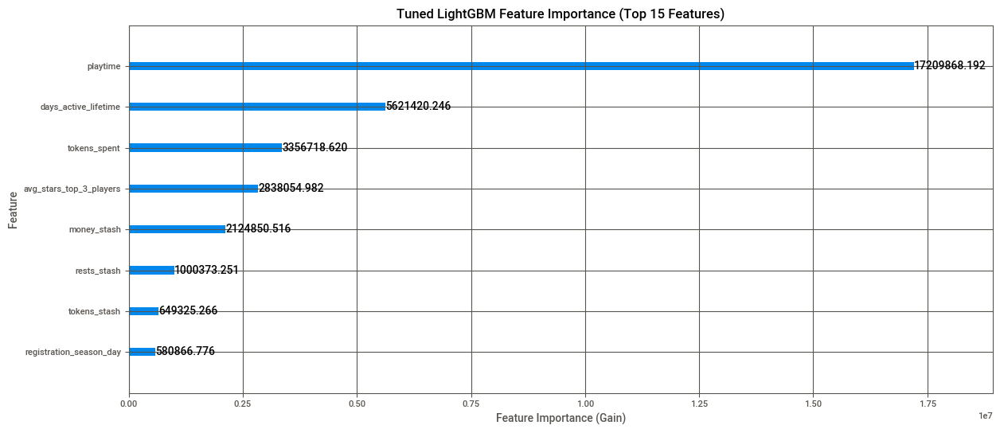

In [583]:
# Plot feature importance using the tuned LightGBM model
lgb.plot_importance(tuned_lgb_model, max_num_features=15, importance_type='gain', ignore_zero=True, figsize=(14, 6))
plt.title("Tuned LightGBM Feature Importance (Top 15 Features)")
plt.xlabel("Feature Importance (Gain)")
plt.ylabel("Feature")
plt.show()

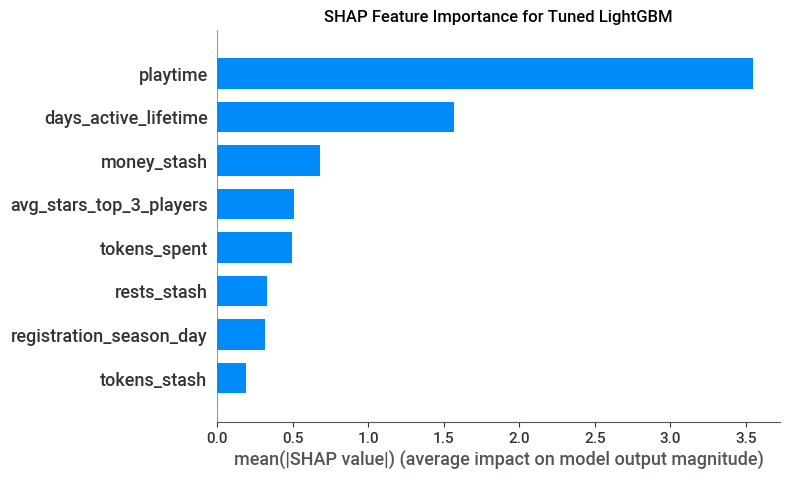

In [584]:
# Drop 'user_id' before scaling 
X_val_scaled_df = pd.DataFrame(X_val_scaled, columns=X_train.drop(columns=['user_id']).columns)

# Initialize the SHAP explainer with the tuned LightGBM model
explainer = shap.TreeExplainer(tuned_lgb_model)

# Calculate SHAP values
shap_values = explainer.shap_values(X_val_scaled_df)

# Create a SHAP summary plot (bar plot)
shap.summary_plot(shap_values, X_val_scaled_df, plot_type="bar", show=False)
plt.title("SHAP Feature Importance for Tuned LightGBM")
plt.show()

Feature importance and SHAP summary plots logged to MLflow.


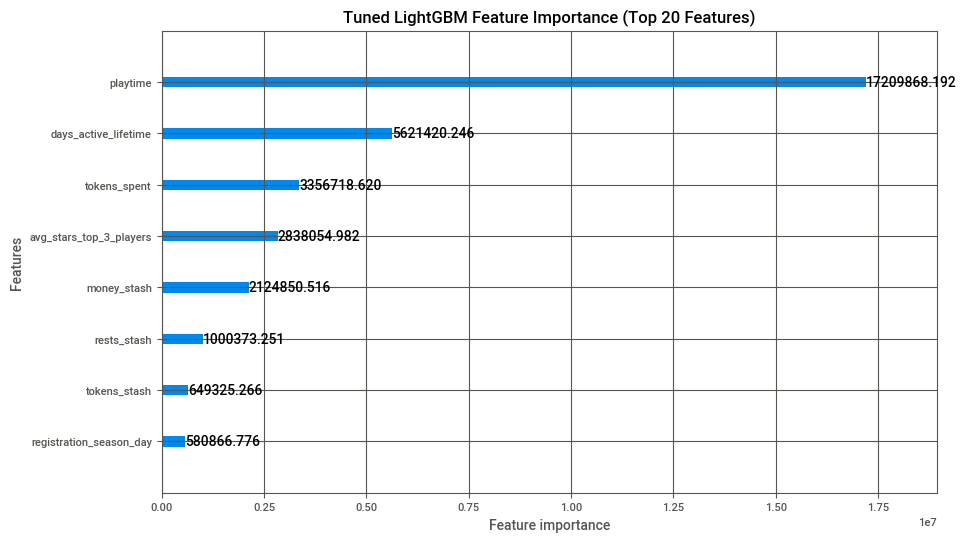

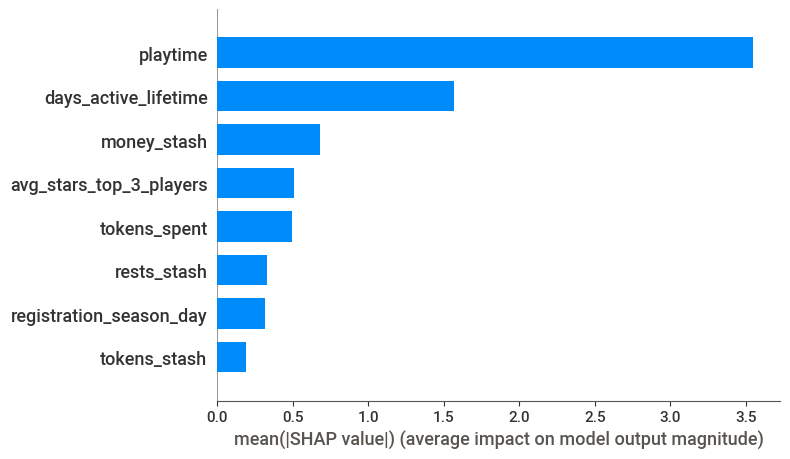

In [585]:
# Ensure the previous run is ended
if mlflow.active_run() is not None:
    mlflow.end_run()

# Start a new MLflow run for logging interpretability artifacts
with mlflow.start_run(run_name="Tuned_LightGBM_Interpretability"):
    # Log the tuned LightGBM model
    mlflow.log_params(best_lgb_params)
    mlflow.sklearn.log_model(tuned_lgb_model, "Tuned_LightGBM_Model")

    # Log LightGBM Feature Importance Plot
    fig, ax = plt.subplots(figsize=(10, 6))
    lgb.plot_importance(tuned_lgb_model, max_num_features=20, importance_type='gain', ax=ax)
    plt.title("Tuned LightGBM Feature Importance (Top 20 Features)")
    importance_plot_path = "tuned_lgb_feature_importance.png"
    plt.savefig(importance_plot_path)
    mlflow.log_artifact(importance_plot_path)

    # Ensure user_id is excluded from SHAP analysis
    X_val_shap = X_val.drop(columns=['user_id'])
    X_val_scaled_df = pd.DataFrame(X_val_scaled, columns=X_val_shap.columns)

    # Calculate SHAP values
    explainer = shap.TreeExplainer(tuned_lgb_model)
    shap_values = explainer.shap_values(X_val_scaled_df)

    # Log SHAP Summary Plot
    plt.figure()
    shap.summary_plot(shap_values, X_val_scaled_df, plot_type="bar", show=False)
    shap_summary_plot_path = "tuned_shap_summary_plot.png"
    plt.savefig(shap_summary_plot_path)
    mlflow.log_artifact(shap_summary_plot_path)

print("Feature importance and SHAP summary plots logged to MLflow.")

# 14. Dimensionality Reduction (PCA)

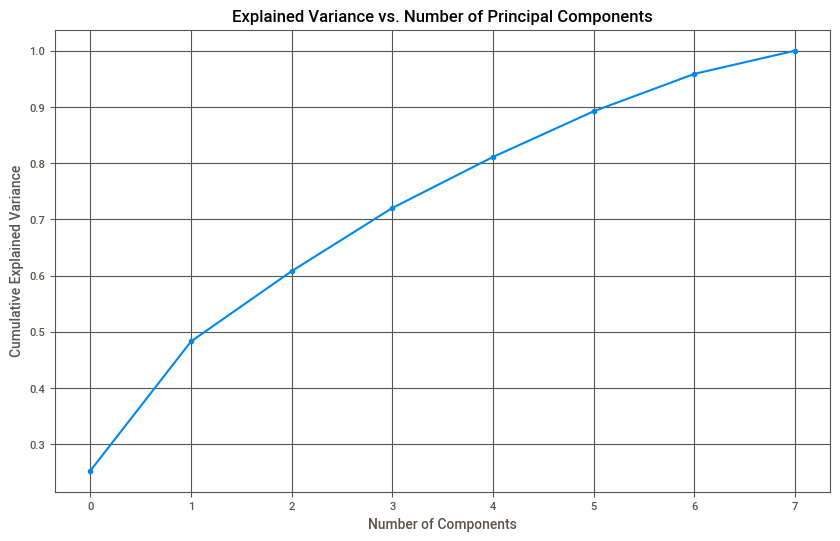

In [586]:
# Initialize PCA
pca = PCA()

# Fit PCA on the scaled training data
pca.fit(X_train_scaled)

# Plot the explained variance ratio to determine the number of components
plt.figure(figsize=(10, 6))
plt.plot(np.cumsum(pca.explained_variance_ratio_), marker='o')
plt.xlabel("Number of Components")
plt.ylabel("Cumulative Explained Variance")
plt.title("Explained Variance vs. Number of Principal Components")
plt.grid()
plt.show()

In [587]:
# Initialize PCA with the selected number of components
pca = PCA(n_components=0.9)

# Fit PCA on the training data and transform both training and validation sets
X_train_pca = pca.fit_transform(X_train_scaled)
X_val_pca = pca.transform(X_val_scaled)

print(f"Reduced dimensions: {X_train_pca.shape[1]}")

Reduced dimensions: 7


In [588]:
# Retrain the LightGBM model using PCA-transformed data
pca_lgb_model = lgb.LGBMRegressor(**best_lgb_params)
pca_lgb_model.fit(
    X_train_pca, y_train,
    eval_set=[(X_val_pca, y_val)],
    callbacks=[lgb.early_stopping(stopping_rounds=100), lgb.log_evaluation(-1)]
)

# Evaluate the model
y_pred_pca = pca_lgb_model.predict(X_val_pca)
mae_pca = mean_absolute_error(y_val, y_pred_pca)

print(f"Tuned LightGBM Model MAE with PCA: {mae_pca:.4f}")

Training until validation scores don't improve for 100 rounds
Did not meet early stopping. Best iteration is:
[923]	valid_0's l2: 64.5531
Tuned LightGBM Model MAE with PCA: 6.0490


In [589]:
# Print the comparison of MAE
print(f"Original Tuned LightGBM MAE: {mae:.4f}")
print(f"\nTuned LightGBM MAE with PCA: {mae_pca:.4f}")

Original Tuned LightGBM MAE: 5.9134

Tuned LightGBM MAE with PCA: 6.0490


In [590]:
# Save the final model
joblib.dump(tuned_lgb_model, r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\models\tuned_lgb_model.pkl")
print("Tuned LightGBM model saved as 'tuned_lgb_model.pkl'")

Tuned LightGBM model saved as 'tuned_lgb_model.pkl'


In [591]:
# Rebuild the FFNN model using the best parameters from Optuna
def build_best_ffnn(params):
    model = Sequential()
    model.add(Input(shape=(X_train_scaled.shape[1],)))
    model.add(Dense(params['n_neurons'], activation='relu'))
    model.add(Dropout(params['dropout_rate']))
    for _ in range(params['n_layers'] - 1):
        model.add(Dense(params['n_neurons'], activation='relu'))
        model.add(Dropout(params['dropout_rate']))
    model.add(Dense(1))  # Output layer for regression

    # Compile the model
    optimizer = Adam(learning_rate=params['learning_rate'])
    model.compile(optimizer=optimizer, loss='mean_absolute_error')

    return model

# Rebuild the FFNN model using the best parameters
best_ffnn_model = build_best_ffnn(best_ffnn_params)

# Train the model
history = best_ffnn_model.fit(
    X_train_scaled, y_train,
    validation_data=(X_val_scaled, y_val),
    epochs=best_ffnn_params['epochs'],
    batch_size=best_ffnn_params['batch_size'],
    verbose=1
)

# Save the model using the native Keras format
best_ffnn_model.save(r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\models\best_ffnn_model.keras")
print("Best FFNN model saved as 'best_ffnn_model.keras'")

Train on 40000 samples, validate on 10000 samples
Epoch 1/60
40000/40000 [==============================] - 7s 178us/sample - loss: 5.8061 - val_loss: 5.6346
Epoch 2/60
40000/40000 [==============================] - 5s 117us/sample - loss: 5.5641 - val_loss: 5.4886
Epoch 3/60
40000/40000 [==============================] - 4s 111us/sample - loss: 5.5212 - val_loss: 5.4992
Epoch 4/60
40000/40000 [==============================] - 5s 118us/sample - loss: 5.4968 - val_loss: 5.4864
Epoch 5/60
40000/40000 [==============================] - 4s 111us/sample - loss: 5.4881 - val_loss: 5.4673
Epoch 6/60
40000/40000 [==============================] - 4s 103us/sample - loss: 5.4716 - val_loss: 5.4712
Epoch 7/60
40000/40000 [==============================] - 4s 103us/sample - loss: 5.4551 - val_loss: 5.4580
Epoch 8/60
40000/40000 [==============================] - 4s 110us/sample - loss: 5.4563 - val_loss: 5.4639
Epoch 9/60
40000/40000 [==============================] - 5s 121us/sample - loss: 5.44

In [592]:
# Make predictions on the validation set
y_val_pred = best_ffnn_model.predict(X_val_scaled)

# Calculate MAE
mae = mean_absolute_error(y_val, y_val_pred)
print(f"Mean Absolute Error (MAE) of the Tuned FFNN Model: {mae:.4f}")


Mean Absolute Error (MAE) of the Tuned FFNN Model: 5.4587


# 15. Predictions on Test Data and Submission Preparation

In [593]:
# Extract only the selected features from the test data
X_test = test_data[selected_features]

# Scale the test data
X_test_scaled = scaler.transform(X_test.drop(columns=['user_id']))

print("Test data scaled successfully.")

# Make predictions on the scaled test data
y_test_pred = best_ffnn_model.predict(X_test_scaled).flatten()

print("Predictions completed successfully.")

# Round the predictions and convert to integers
y_test_pred = np.rint(y_test_pred).astype(int)

# Ensure the predictions are within the valid range [0, 28]
y_test_pred = np.clip(y_test_pred, 0, 28)

print("Predictions adjusted successfully.")

# Prepare the submission DataFrame
submission = pd.DataFrame({
    'user_id': test_data['user_id'],
    'predicted_days_active_first_28_days_after_registration': y_test_pred
})

# Save the submission file
submission_path = r"C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\output\days_active_first_28_days_after_registration_predictions.csv"
submission.to_csv(submission_path, index=False)

print(f"Submission file saved successfully to: {submission_path}")

Test data scaled successfully.
Predictions completed successfully.
Predictions adjusted successfully.
Submission file saved successfully to: C:\Users\User\Projects_for_Competitions_Companies\Nordeus_Data_Science_Challenge_2024\output\days_active_first_28_days_after_registration_predictions.csv


In [594]:
# Display the first few rows of the submission file
submission.head()

,user_id,predicted_days_active_first_28_days_after_registration
0,300004,2
1,300006,21
2,300012,2
3,300022,1
4,300031,12


In [595]:
submission['predicted_days_active_first_28_days_after_registration'].value_counts()

0     17594
1      4747
2      4011
3      2581
4      2001
5      1709
6      1575
8      1509
7      1478
9      1368
10     1306
11     1151
12     1109
13      959
14      868
15      743
18      682
16      672
17      667
19      637
20      605
21      557
22      462
23      376
24      258
25      166
26       91
28       66
27       52
Name: predicted_days_active_first_28_days_after_registration, dtype: int64

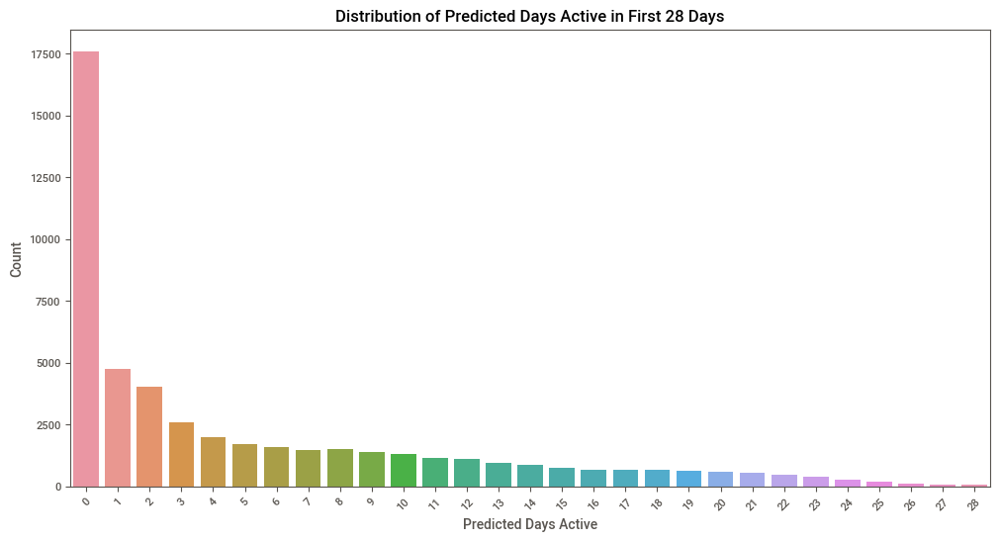

In [597]:
# Get the value counts of predictions
prediction_counts = submission['predicted_days_active_first_28_days_after_registration'].value_counts().sort_index()

# Create a bar plot
plt.figure(figsize=(12, 6))
sns.barplot(x=prediction_counts.index, y=prediction_counts.values)
plt.title("Distribution of Predicted Days Active in First 28 Days")
plt.xlabel("Predicted Days Active")
plt.ylabel("Count")
plt.xticks(rotation=45)
plt.show()